In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

import glob
import sys
import os
WaterNets_project_path = "../../RemoteSensing_Environment_Projects/WaterNets_project"
#change it with the appropriate path
sys.path.append(os.path.abspath(WaterNets_project_path))

import sediment_utils

import rasterio
from matplotlib import colors
from tqdm import tqdm

import warnings
warnings.filterwarnings("ignore")

from rasterio import logging
log = logging.getLogger()
log.setLevel(logging.ERROR)


In [2]:
NN_files_dir = "../NN_Scaler/" # change with the location where you have these files

In [3]:
BCLWMasks = tf.keras.models.load_model(NN_files_dir+"BCLWMasks.h5")
SimpleScaler = sediment_utils.SimpleScaler
import joblib
scaler_filename = NN_files_dir+"scaler_BCLW.gz"
scaler_BCLW = joblib.load(scaler_filename)

In [4]:
import joblib
scaler_filename = NN_files_dir+"scaler_BCLW.gz"
scaler_BCLW = joblib.load(scaler_filename)


In [5]:
#This scales the image colours so that it looks nice
def scale_im(reader, satellite="ls8"):
    if satellite == "ls8":
      red = reader.read(3)
      green = reader.read(2)
      blue = reader.read(1)
    if satellite == "ls7":
      red = reader.read(3)/256*1.0333-0.0029
      green = reader.read(2)/256*0.9885+ 0.0014
      blue = reader.read(1)/256*1.0026+0.0009
    return np.dstack([(red), (green), (blue)])

In [6]:
from matplotlib import colors


In [7]:
cmap_masks = colors.ListedColormap([ 'lightblue', 'blue', 'white', 'black',])


From table 1 here https://openprairie.sdstate.edu/cgi/viewcontent.cgi?referer=https://scholar.google.com/&httpsredir=1&article=1035&context=gsce_pubs how to harmonize ETM+ (Landsat7) and OLI (landSat8)

In [8]:
def plot_predictionL7(path_main_directory):
    if not os.path.isdir(path_main_directory):
        return "Main directory does not exist."

    contents = os.listdir(path_main_directory)

    subdirectory_RAW = path_main_directory
    list_date = os.listdir(subdirectory_RAW)

    prediction_count = 0  # To count number of predictions plotted

    for dirpath, dirnames, filenames in os.walk(subdirectory_RAW):
        if filenames:
            for filename in filenames:
                # Limit to 3 predictions per location
                if prediction_count >= 10:
                    break  # Stop plotting more predictions for this location


                file_path = os.path.join(dirpath, filename)
                # Plotting and image processing starts here
                if os.path.isfile(file_path) == True:

                  RAW_reader = rasterio.open(file_path)
                  image_shape = RAW_reader.read(1).shape
                  raw_image = np.dstack([
                      RAW_reader.read(1)/255*65535*1.0333-0.0029,
                      RAW_reader.read(2)/255*65535*0.9885+ 0.0014,
                      RAW_reader.read(3)/255*65535*1.0026+0.0009,
                      RAW_reader.read(4)/255*65535*1.1007-0.0058,
                      RAW_reader.read(5)/255*65535*1.0659-0.0001,
                      RAW_reader.read(8)/255*65535*1.0983+0.0048,
                  ])

                  test_image = scale_im(RAW_reader, satellite="ls7")

                  # Resize the images
                  test_image_water = scaler_BCLW.transform(raw_image.reshape((image_shape[0], image_shape[1], 6)))
                  test_image_water = np.clip(test_image_water, 0.06047150377660792, 1.)
                  # clip to the minimum and max of LandSat8 data               

                  predictions = BCLWMasks(test_image_water.reshape((np.product(image_shape), 6)))
                  predicted_classes = np.argmax(predictions, axis=1)

                  # Plotting
                  fig, ax = plt.subplots(1, 2, dpi=150)
                  ax[0].imshow(test_image)
                  ax[0].title.set_text('RGB Raw image')

                  im = ax[1].imshow(predicted_classes.reshape((image_shape[0], image_shape[1])), cmap=cmap_masks, interpolation="none", vmin=0, vmax=3)
                  cbar = fig.colorbar(im, pad=0.05, fraction=0.046)
                  cbar.set_ticks([0, 1, 2, 3])
                  cbar.set_ticklabels(["land", "water", "cloud", "blank"])

                  ax[1].title.set_text('Keras BCWL Model')

                  plt.show()

                  # Close the figure after displaying it
                  plt.close()

                  # Increment the prediction count
                  prediction_count += 1
              # If 3 predictions have been plotted, break out of the loop and move to the next subdirectory



Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


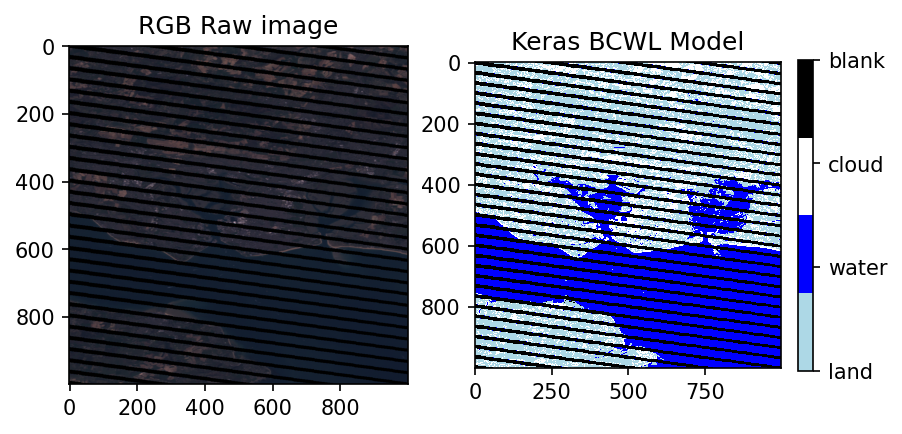

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


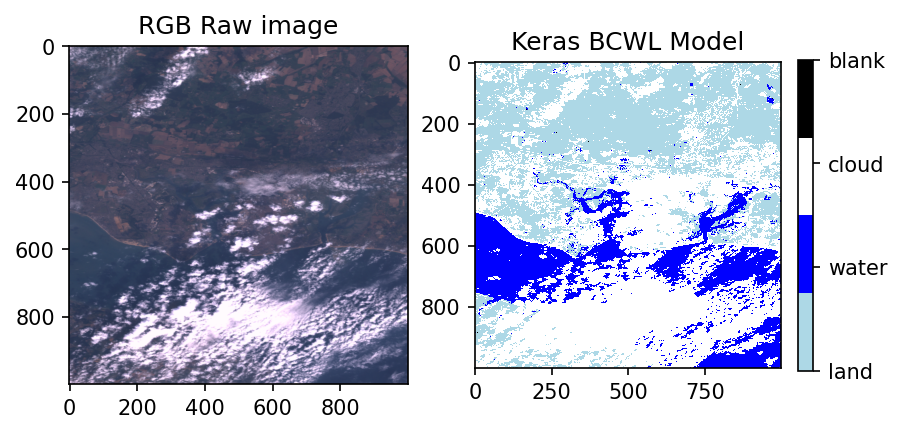

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


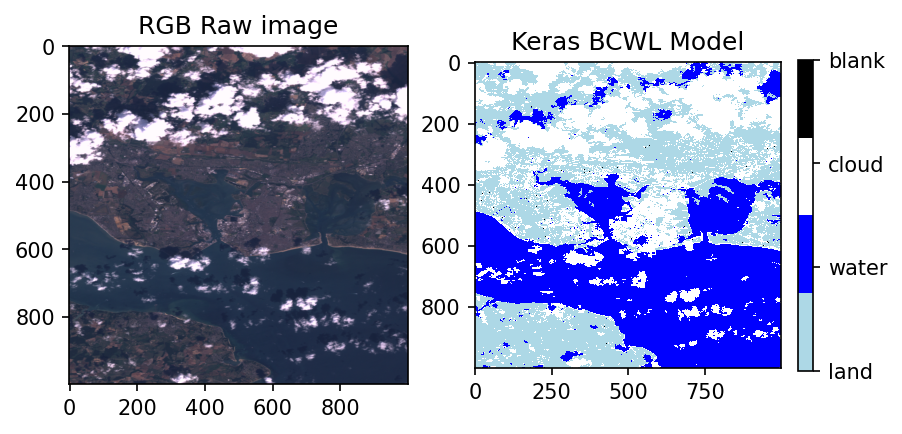

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


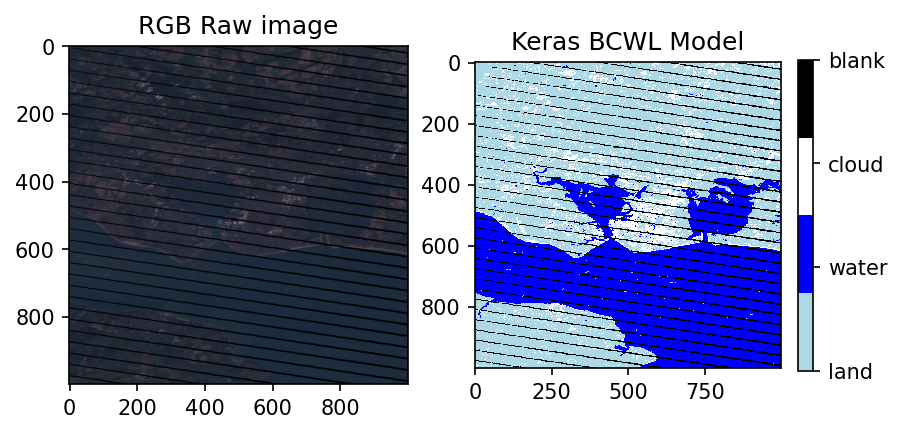

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


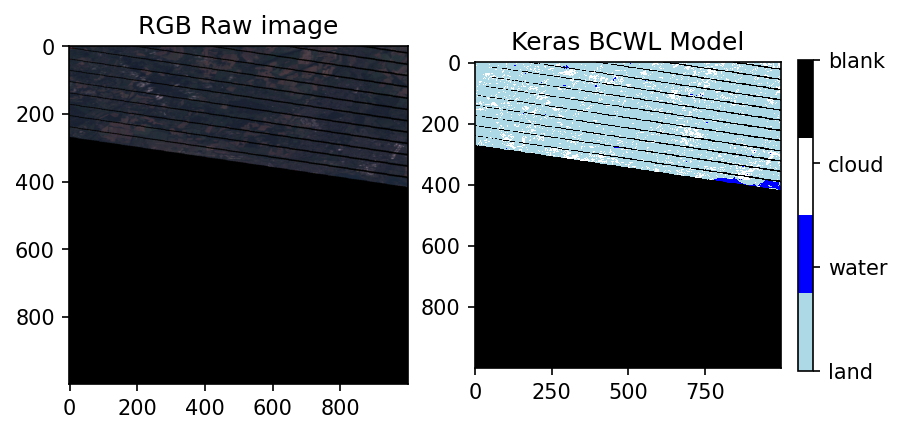

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


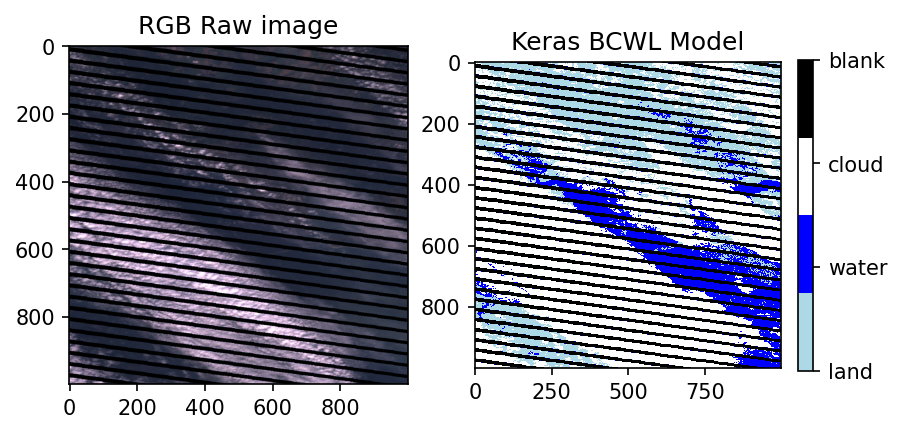

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


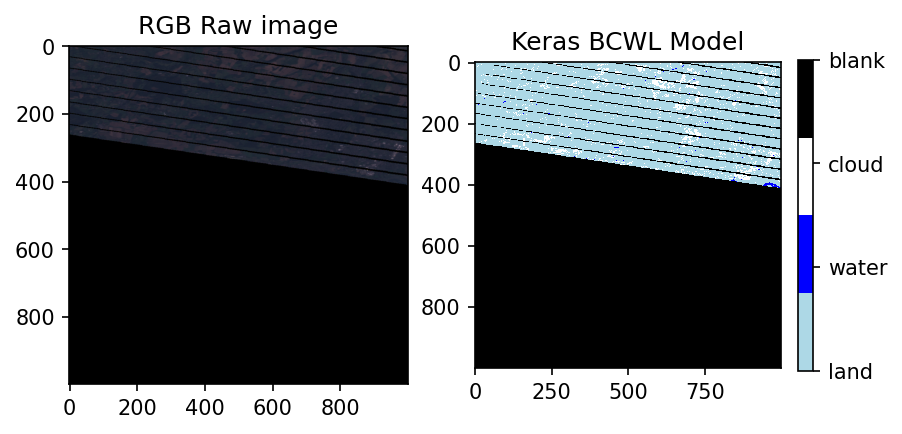

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


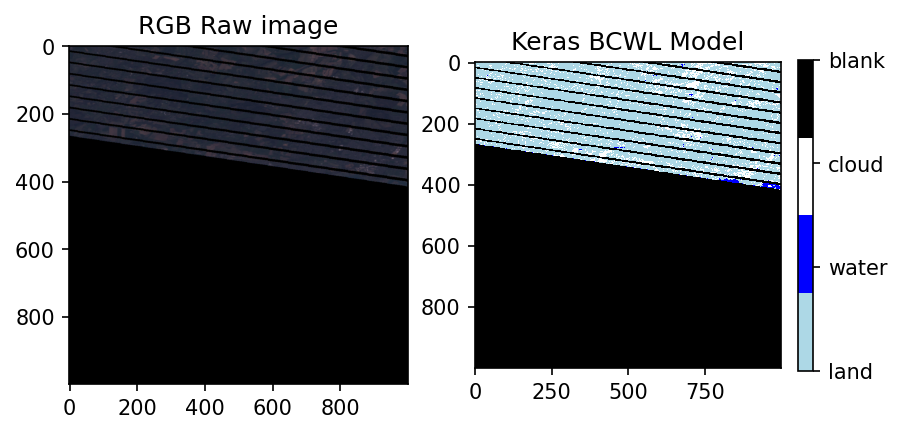

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


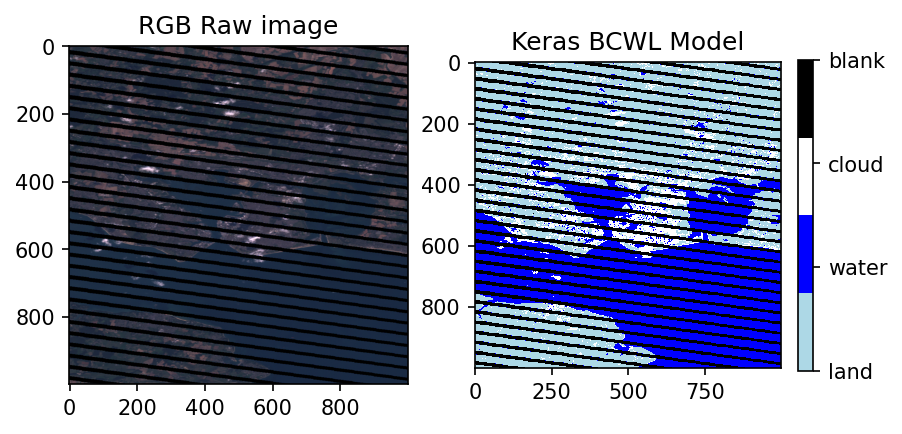

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


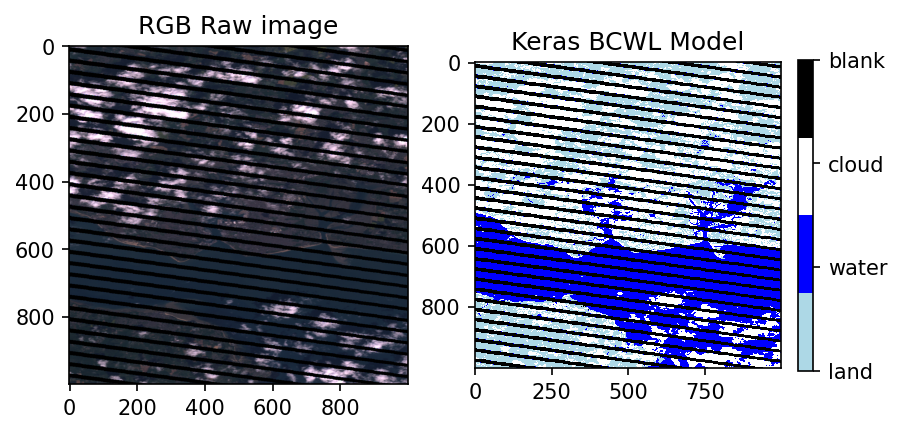

In [9]:
plot_predictionL7('./L7/Portsmouth/')

In [12]:
class Sediment():
    """
    A Class for definition of Sediment proxy
    """
    def __init__(self, reader, water_mask):
        
        self.reader = reader
        self.swir = reader.read(5)
        self.swir2 = reader.read(6)

        self.nir = reader.read(4)
        self.red = reader.read(3)
        self.green = reader.read(2)
        self.blue = reader.read(1)
        
        self.water_mask = water_mask
        
    def TSS(self, ):
      """
      ### TOTAL SUSPENDED SEDIMENT (tss)

      """
      TSS_img = 3957*(((self.green + self.red)*0.001) / 2)*1.6436
      img = np.where(self.water_mask == 1, TSS_img, np.nan)
      return img
        
    def NSMI(self, ):
      """
      ### Normalized Difference Suspended Material Index (NSMI)
        - **Formula**: \((Red + Green - Blue) / (Red + Green + Blue)\)


      """
      NSMI_img = (self.red + self.green - self.blue) / (self.red + self.green + self.blue)
      img = np.where(self.water_mask == 1, NSMI_img, np.nan)
      return img

In [13]:
def sediment_val_dist(path_main_directory, scaler, nn):
    if not os.path.isdir(path_main_directory):
        return "Main directory does not exist."
    prediction_count = 0  # To count number of predictions plotted

    contents = os.listdir(path_main_directory)

    subdirectory = path_main_directory
    TSS_arr = []
    NSMI_arr = []
    for dirpath, dirnames, filenames in os.walk(subdirectory):
        if filenames:
            for filename in filenames:

              file_path = os.path.join(dirpath, filename)
              # Plotting and image processing starts here
              if os.path.isfile(file_path) == True:
               
                RAW_reader = rasterio.open(file_path)
                image_shape = RAW_reader.read(1).shape
                raw_image = np.dstack([
                      RAW_reader.read(1)/255*65535*1.0333-0.0029,
                      RAW_reader.read(2)/255*65535*0.9885+ 0.0014,
                      RAW_reader.read(3)/255*65535*1.0026+0.0009,
                      RAW_reader.read(4)/255*65535*1.1007-0.0058,
                      RAW_reader.read(5)/255*65535*1.0659-0.0001,
                      RAW_reader.read(8)/255*65535*1.0983+0.0048,
                  ])


                test_image_water = scaler.transform(raw_image.reshape((image_shape[0], image_shape[1], 6)))
                test_image_water = np.clip(test_image_water, 0.06047150377660792, 1.)

                predictions = nn(test_image_water.reshape((np.product(image_shape), 6)))
                predicted_classes = np.argmax(predictions, axis=1)

                rgb_image  = scale_im(RAW_reader)
                # Plotting
                fig, ax = plt.subplots(1, 3, figsize=(14,6.5))
                ax[0].imshow(rgb_image)
                ax[0].title.set_text('RGB image')

                TSS_img = Sediment(RAW_reader, predicted_classes.reshape((image_shape[0], image_shape[1]))).TSS().reshape((image_shape[0], image_shape[1]))
                
                im0 = ax[1].imshow(TSS_img, cmap="YlGnBu_r")
                cbar = fig.colorbar(im0, pad=0.05, fraction=0.046)
                ax[1].title.set_text('TSS_img_deg')
                
                ####
                NSMI_img = Sediment(RAW_reader, predicted_classes.reshape((image_shape[0], image_shape[1]))).NSMI().reshape((image_shape[0], image_shape[1]))
                
                im0 = ax[2].imshow(NSMI_img, cmap="YlGnBu_r")
                cbar = fig.colorbar(im0, pad=0.05, fraction=0.046)
                ax[2].title.set_text('NDSSI_img_deg nir')
                
                plt.show()
                
                # Close the figure after displaying it
                plt.close()

                TSS_arr.append(TSS_img)
                NSMI_arr.append(NSMI_img)  
    return TSS_arr, NSMI_arr

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


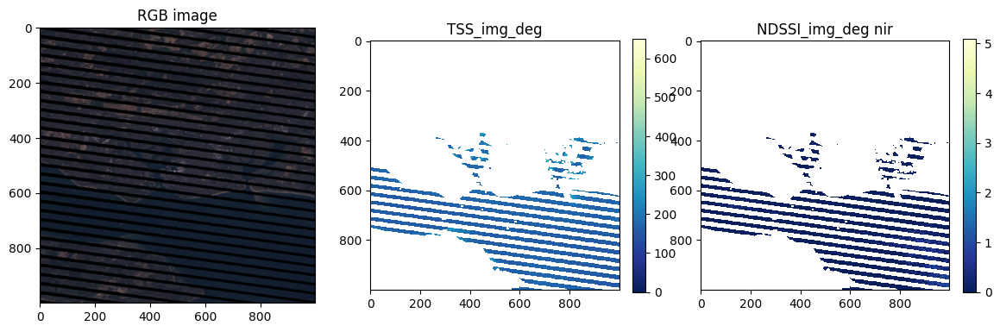

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


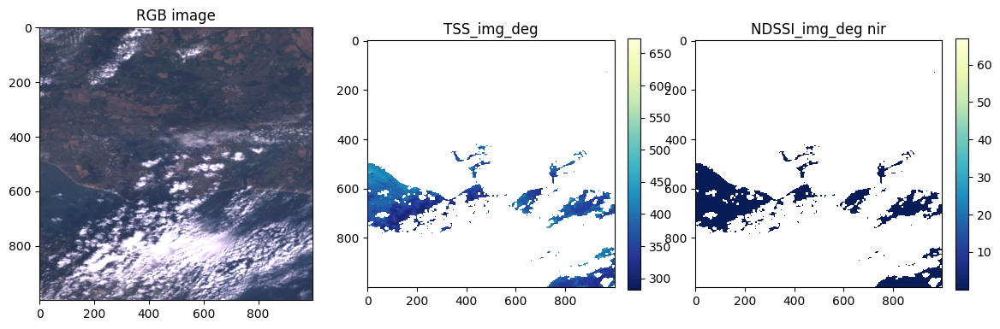

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


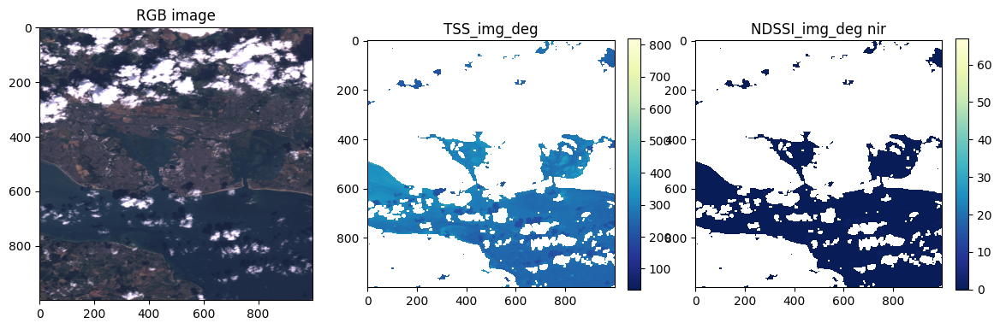

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


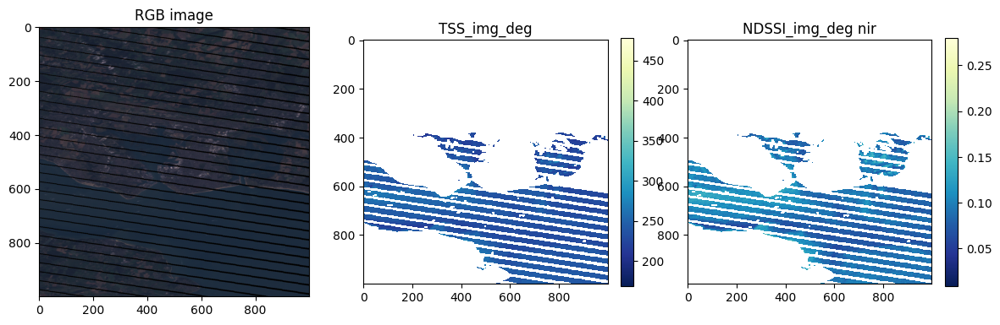

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


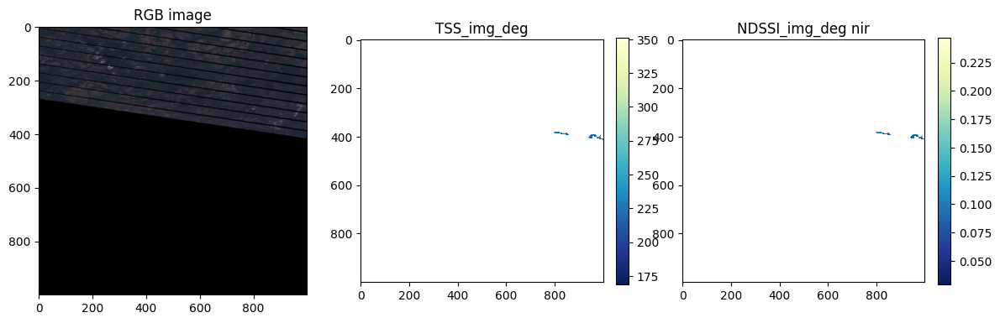

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


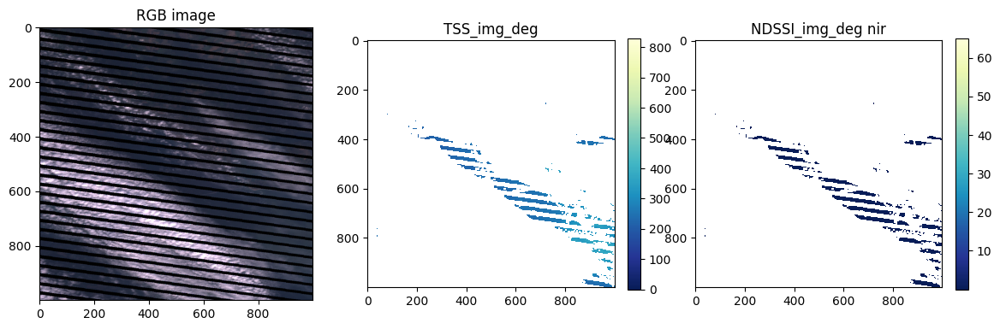

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


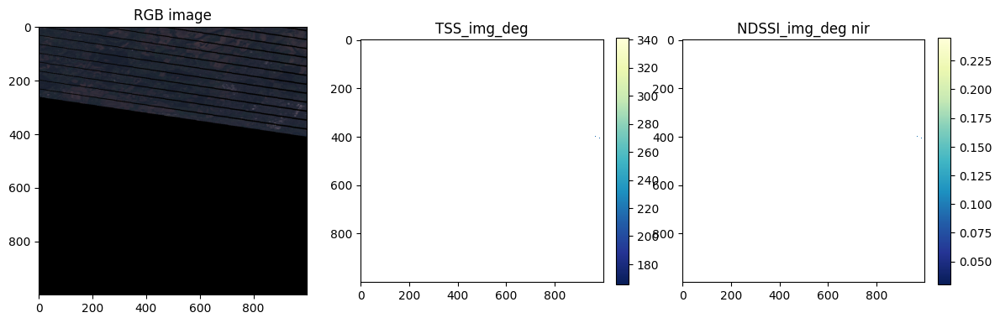

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


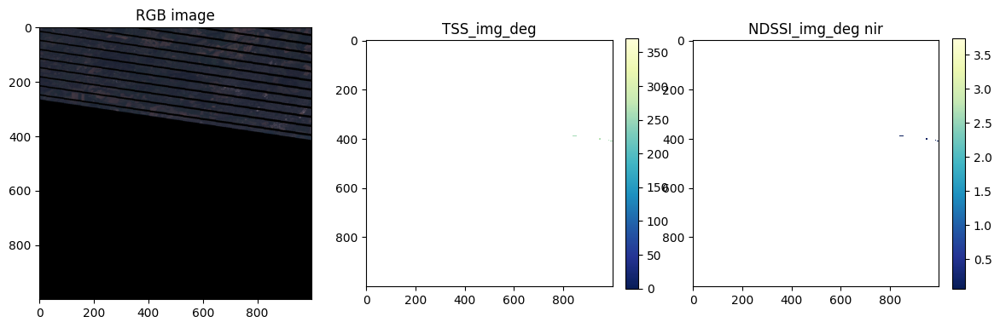

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


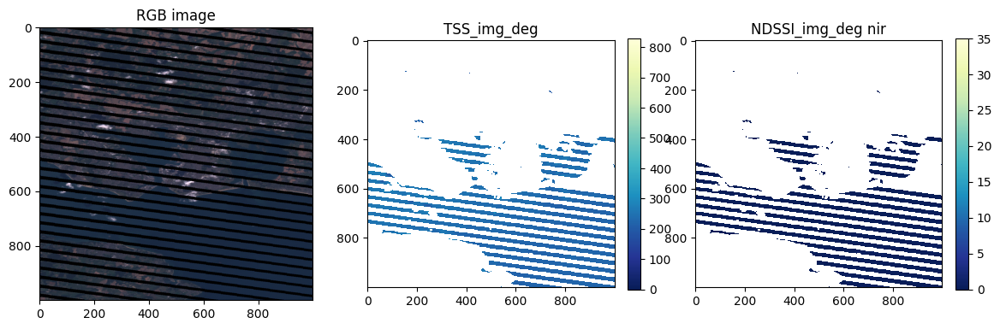

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


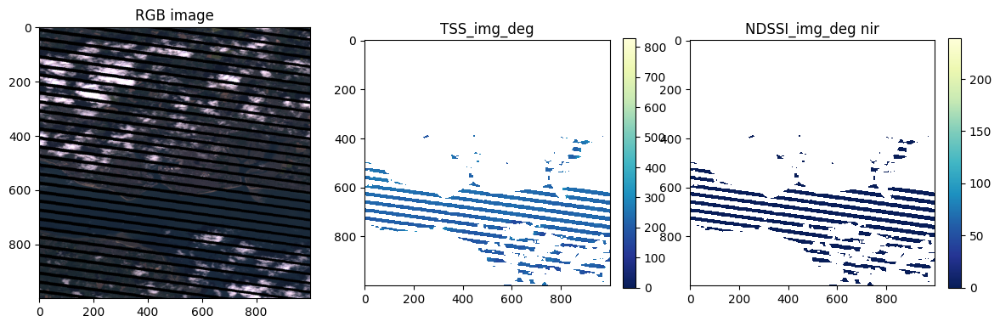

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


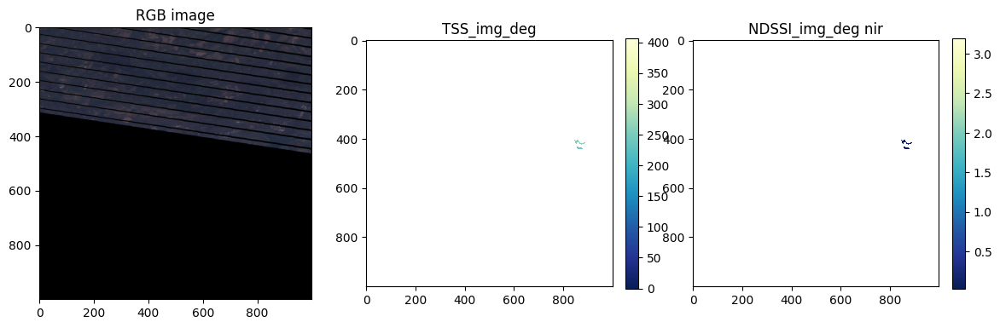

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


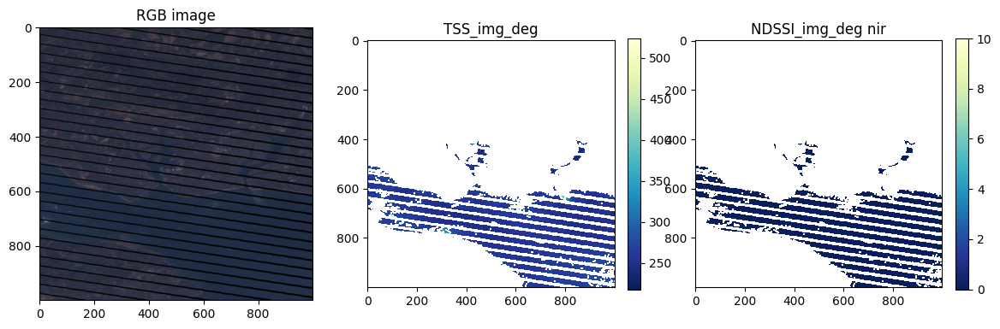

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


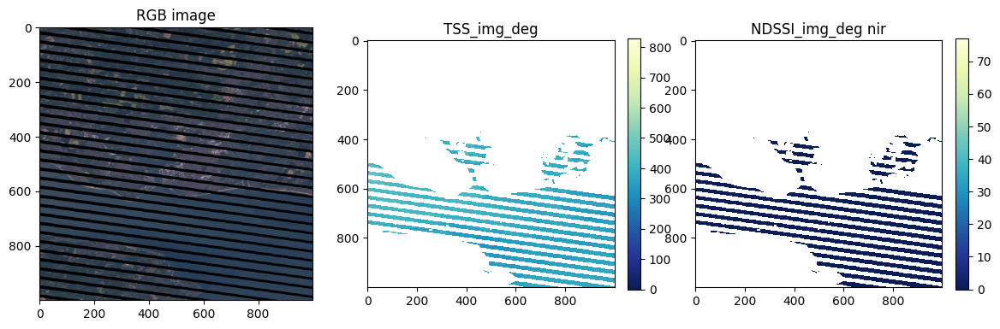

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


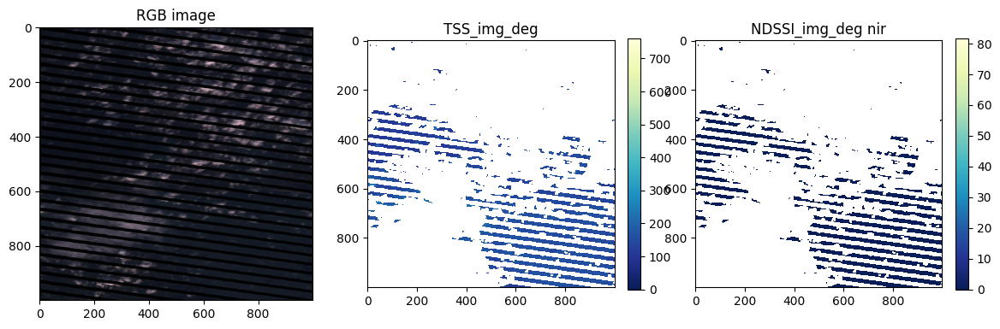

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


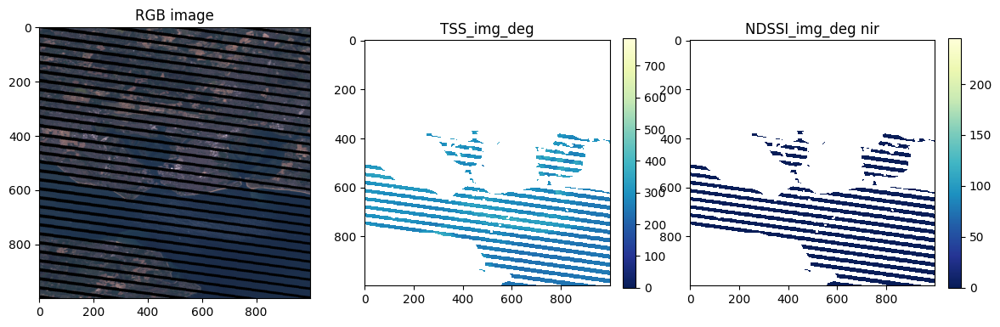

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


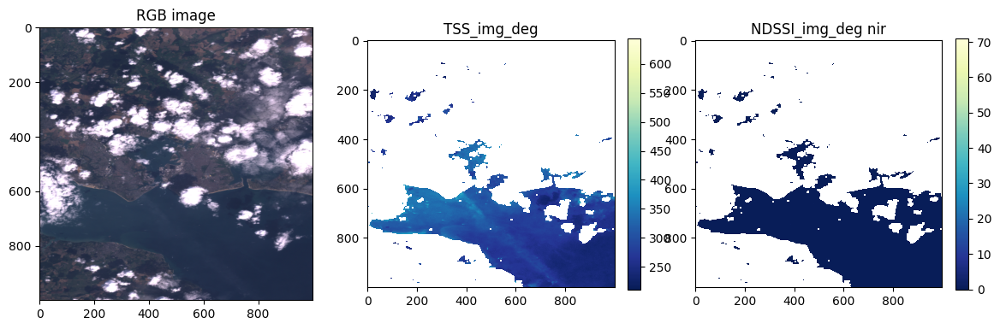

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


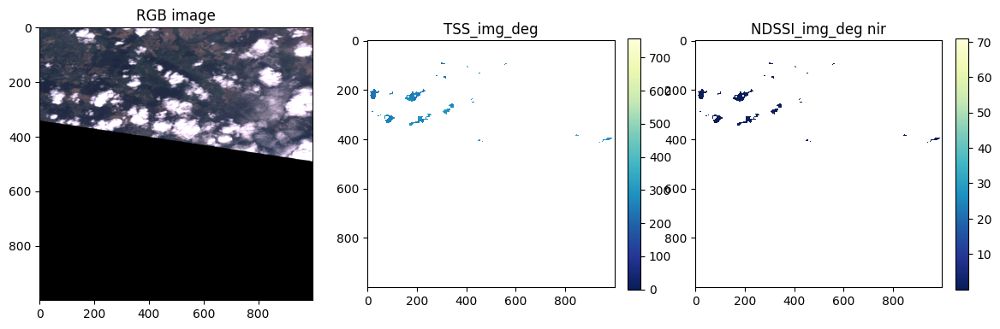

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


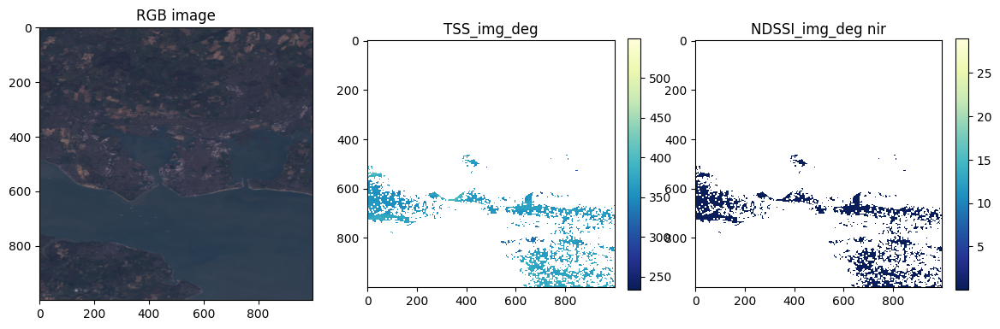

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


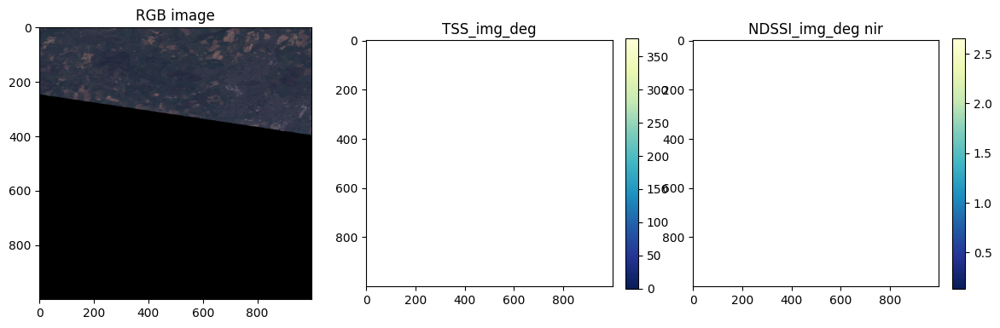

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


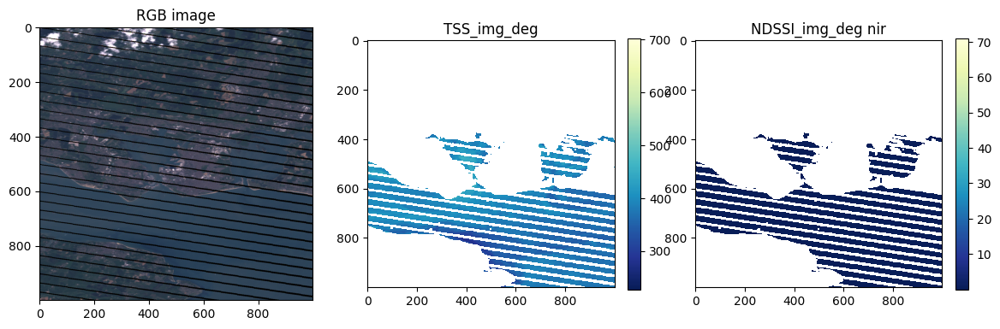

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


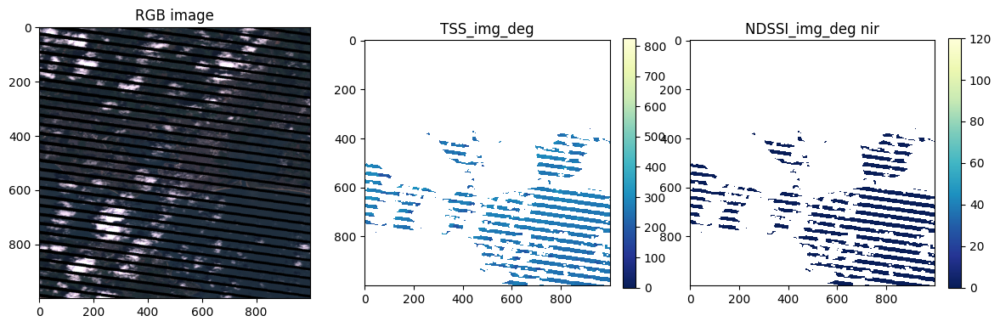

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


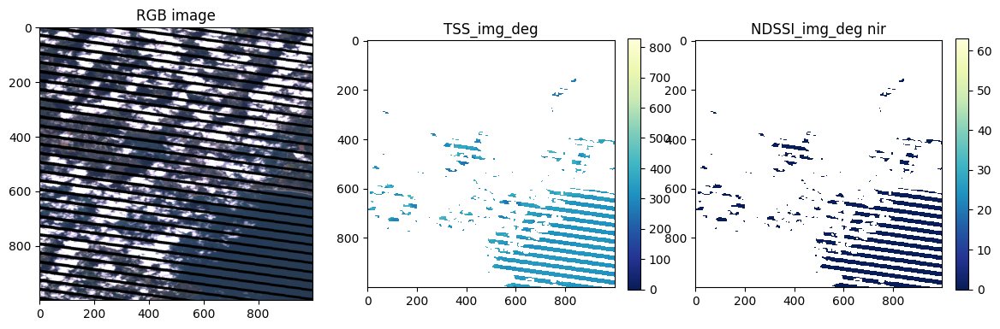

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


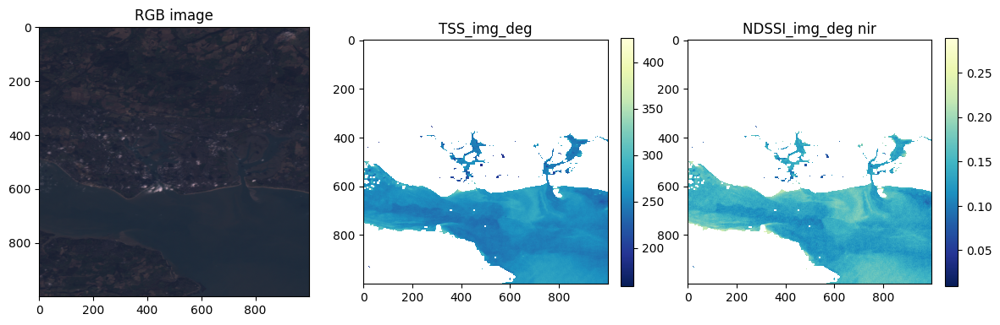

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


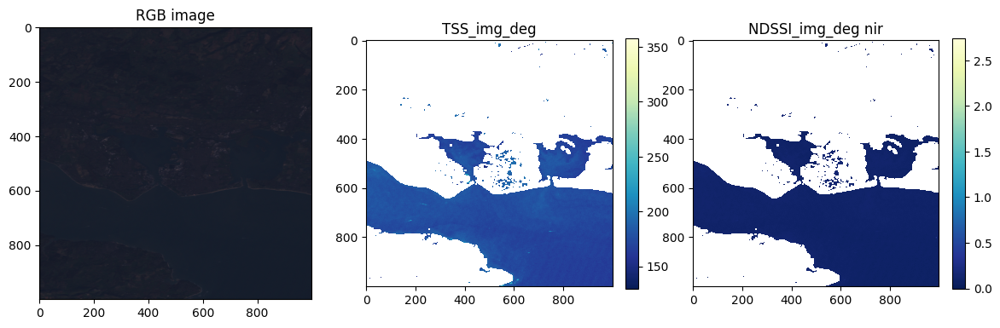

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


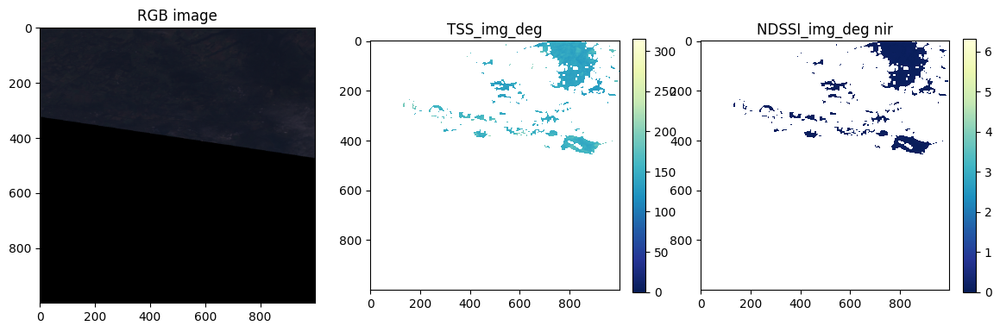

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


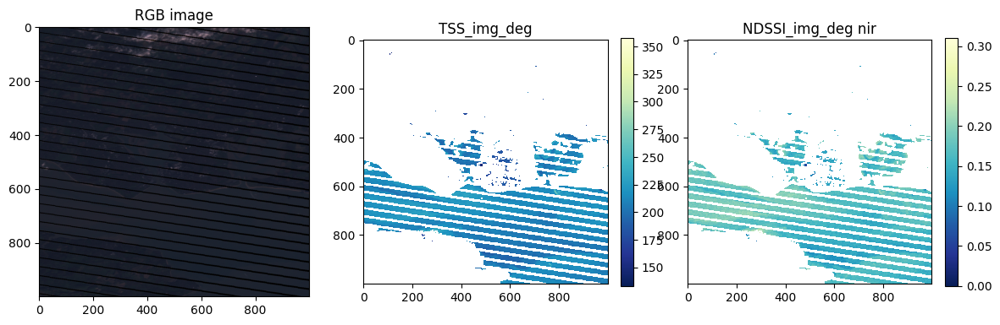

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


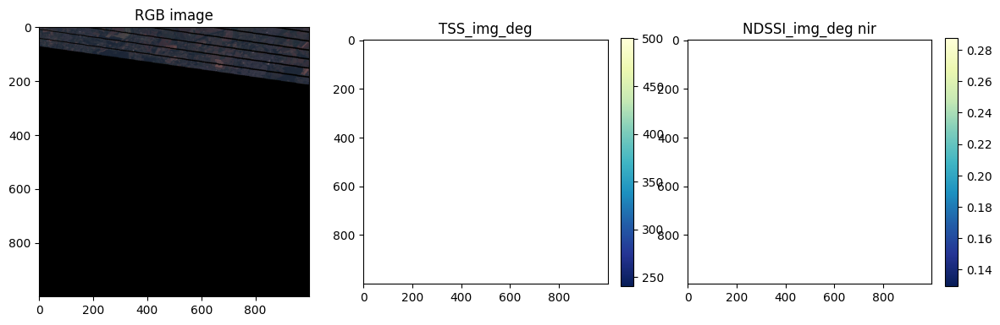

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


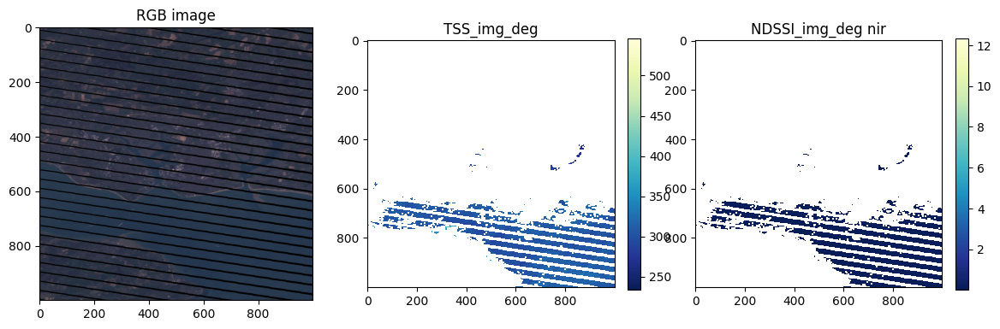

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


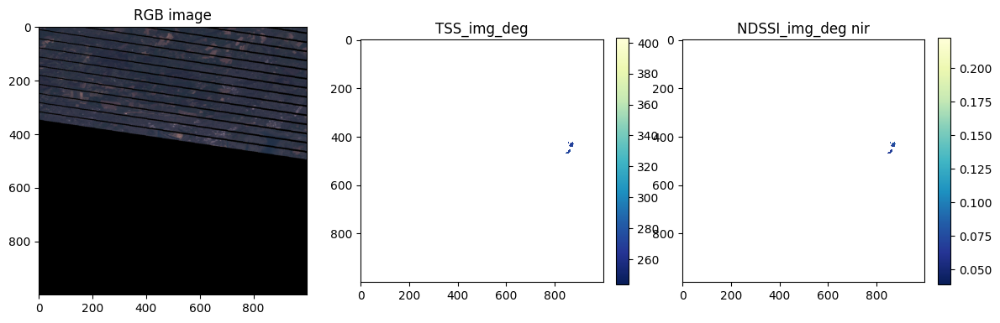

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


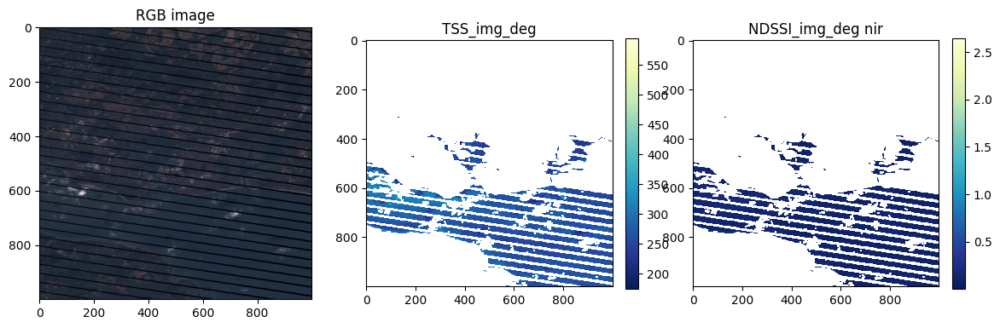

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


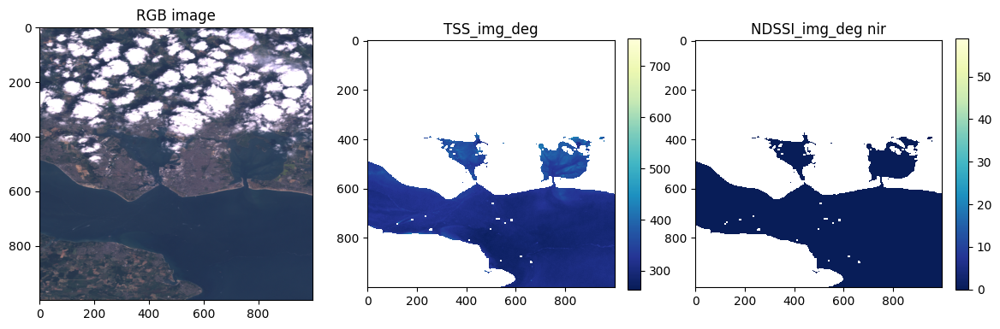

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


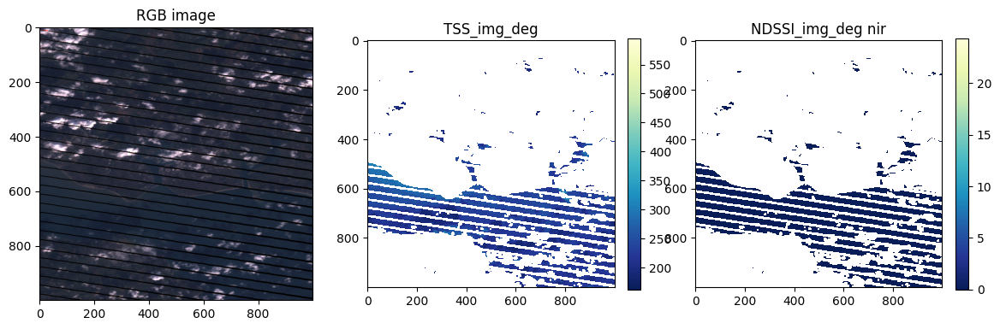

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


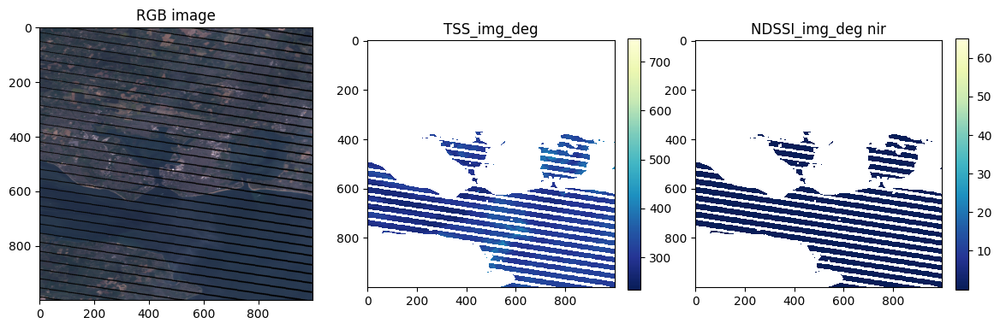

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


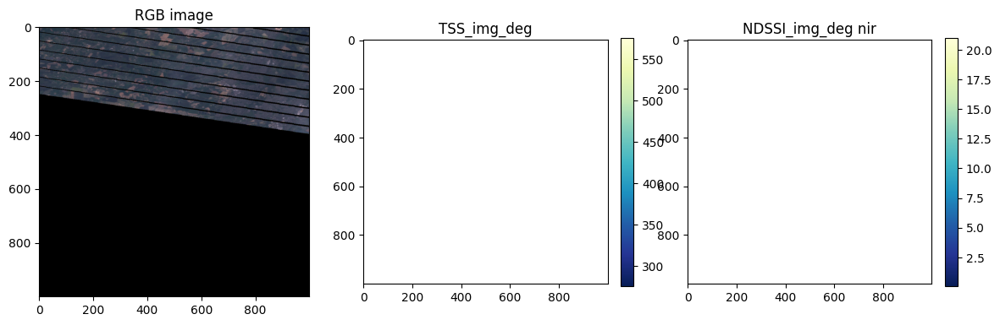

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


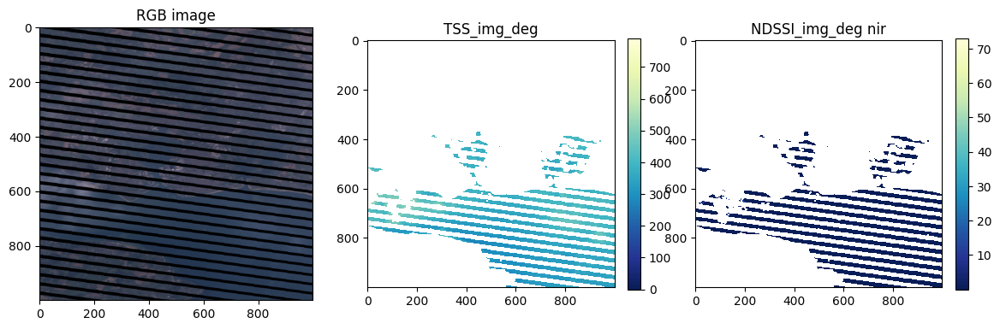

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


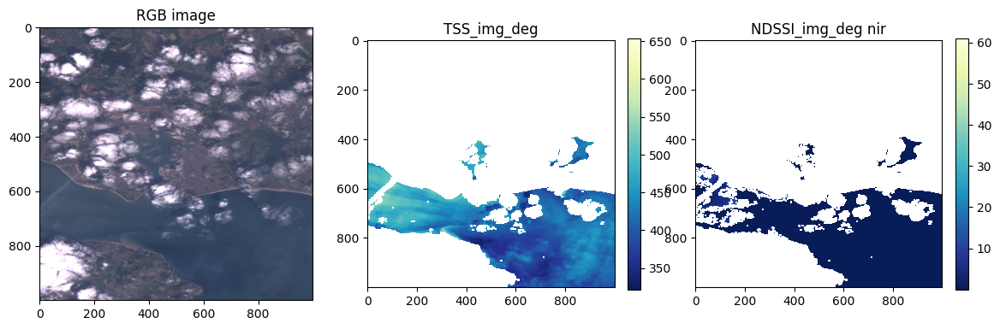

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


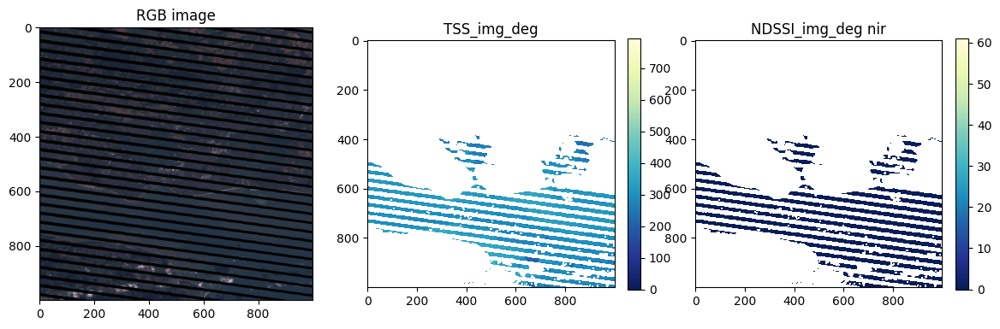

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


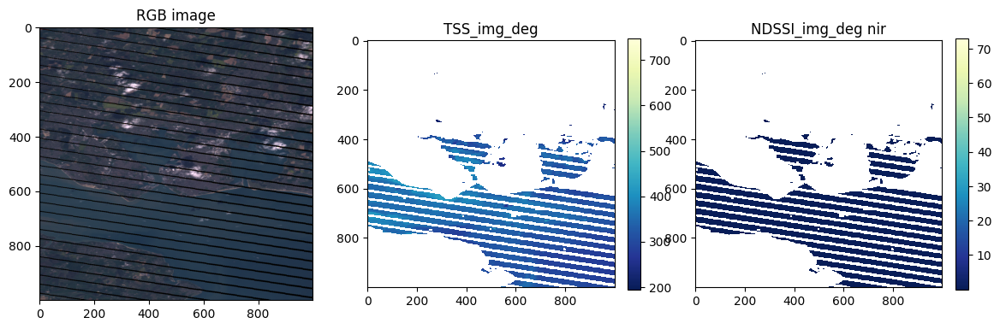

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


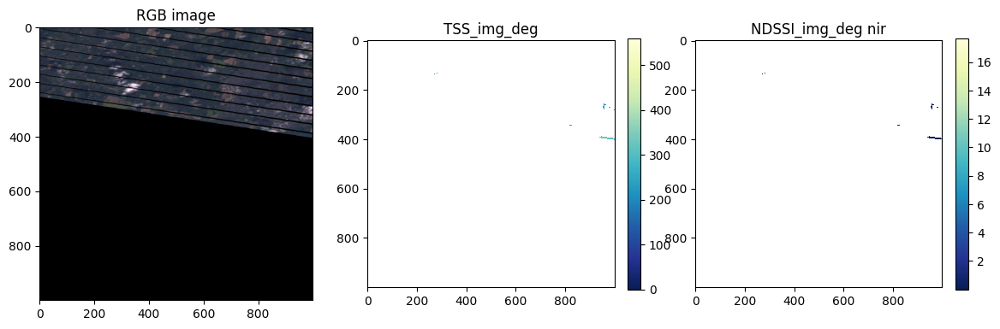

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


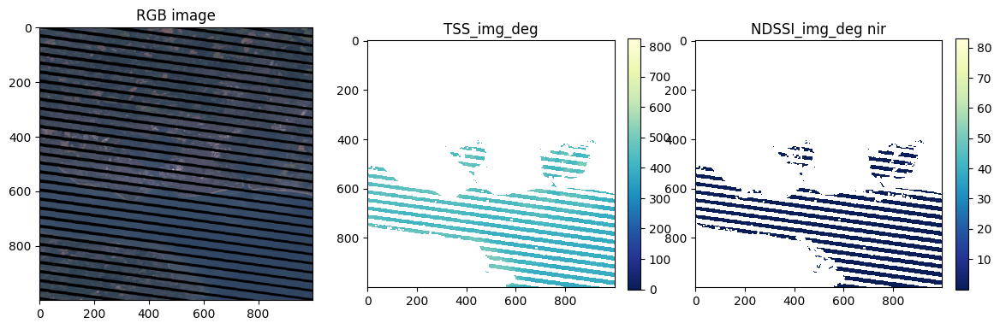

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


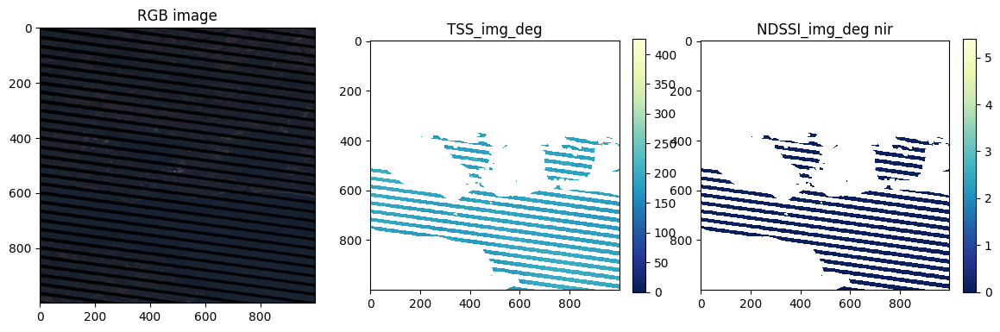

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


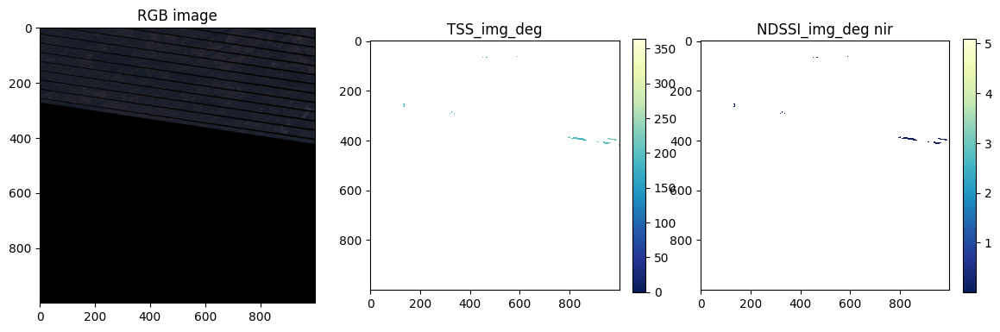

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


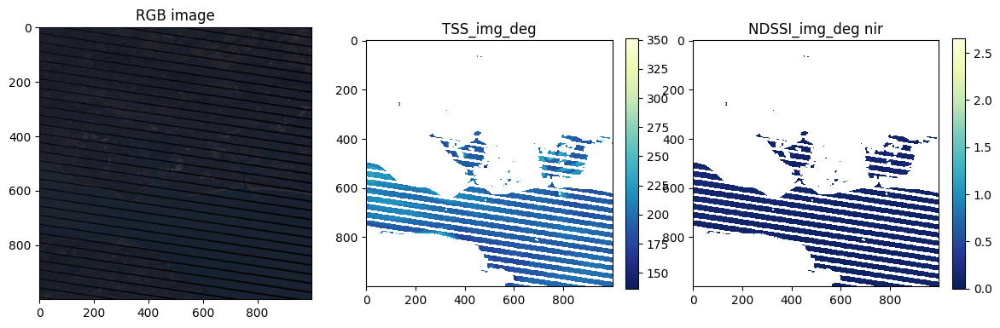

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


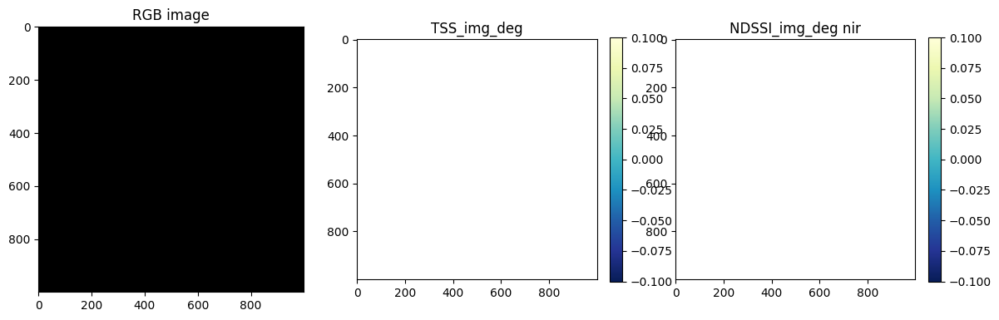

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


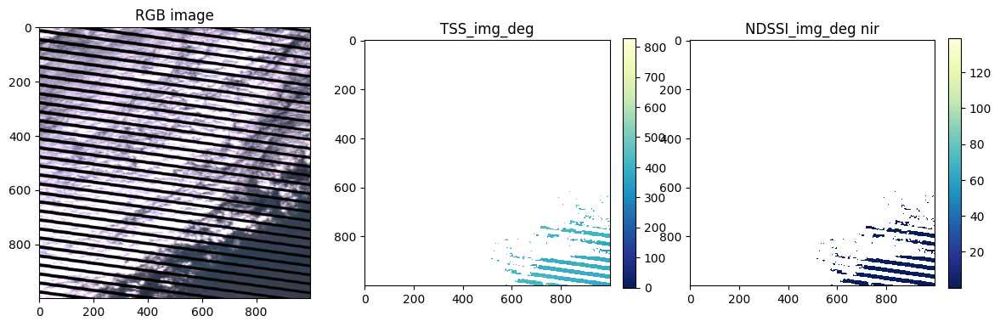

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


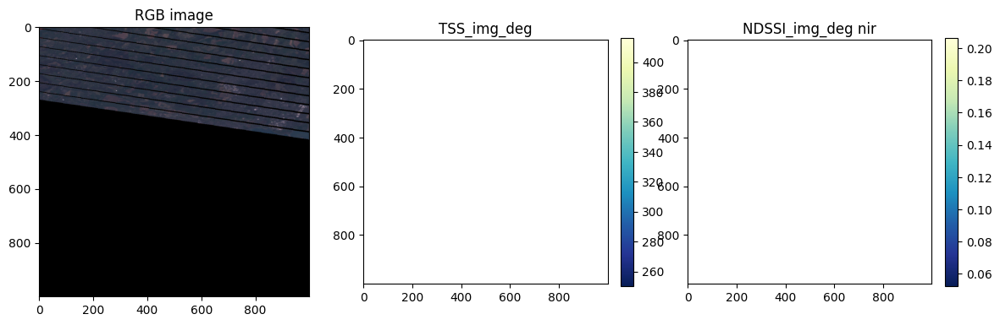

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


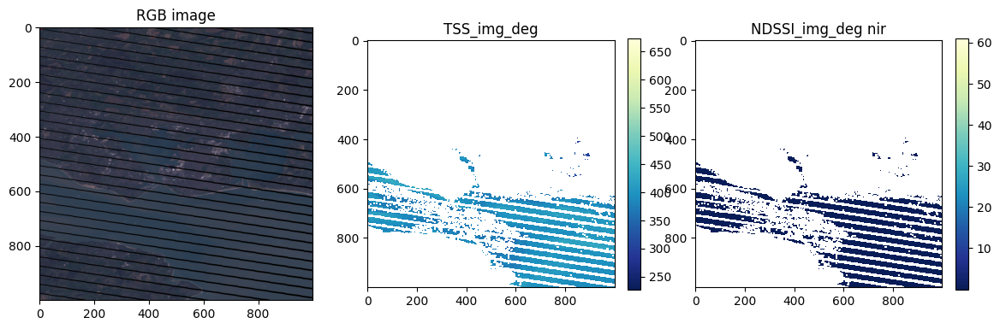

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


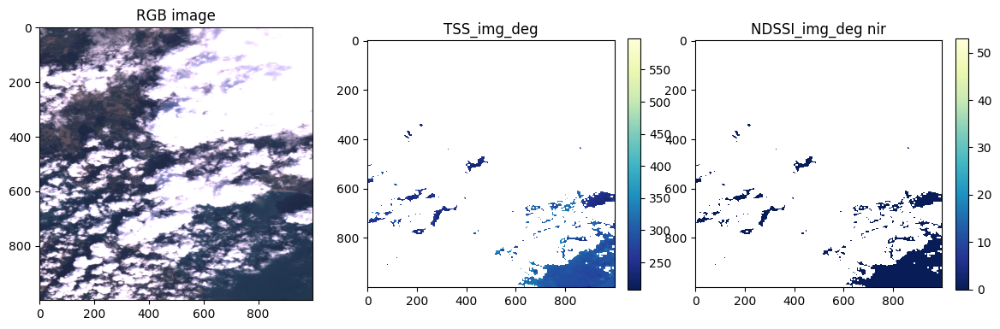

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


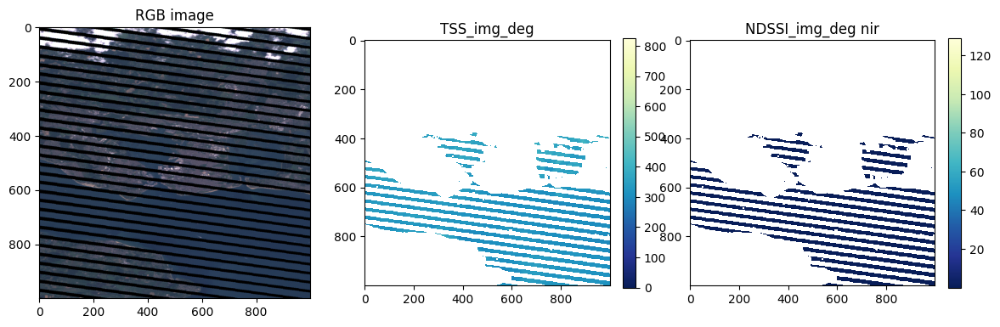

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


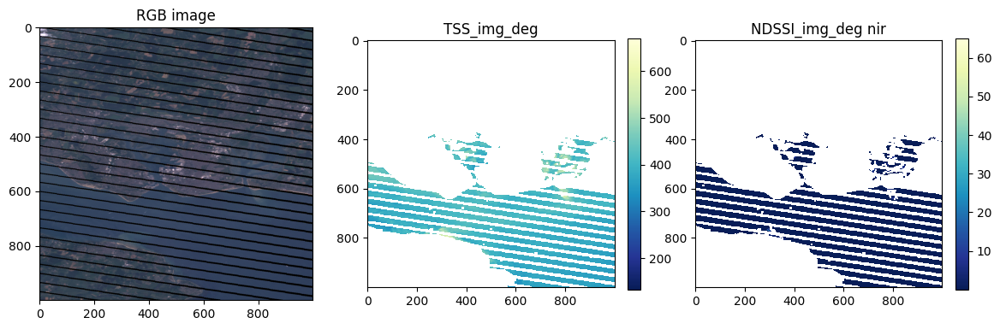

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


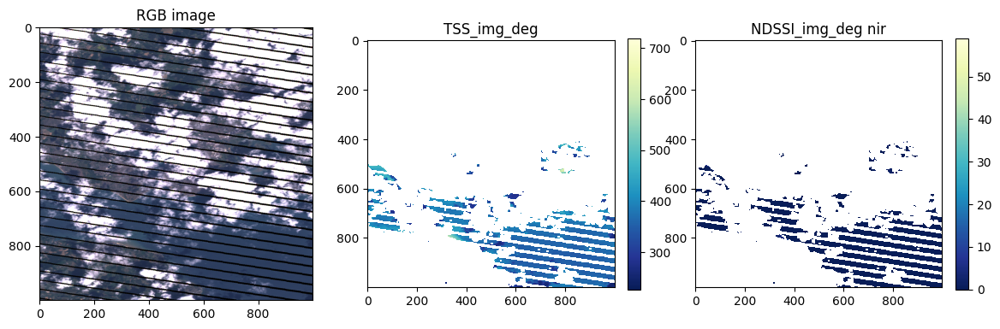

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


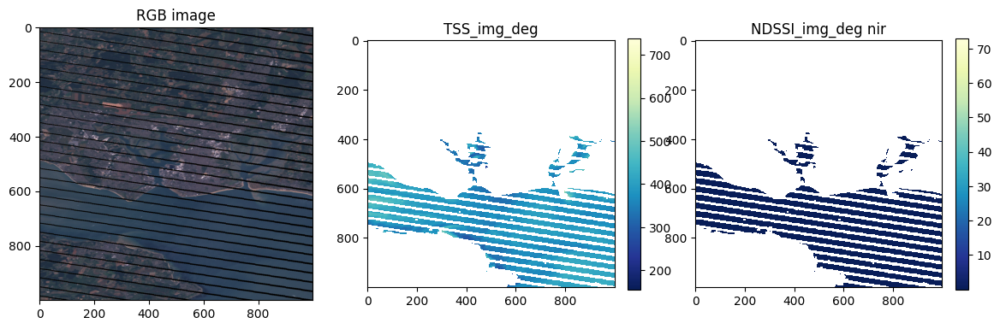

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


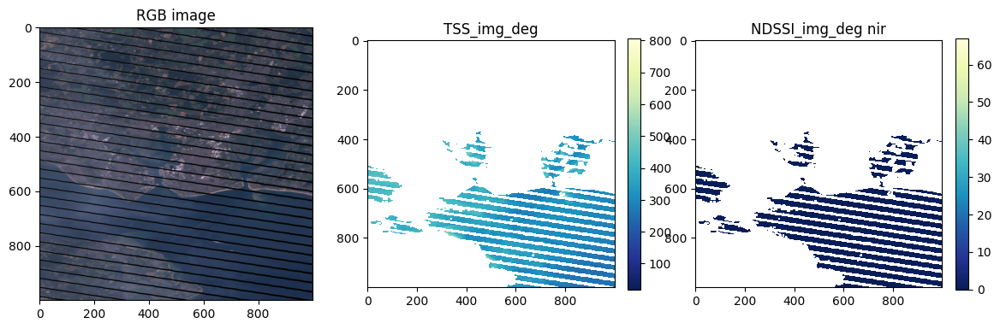

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


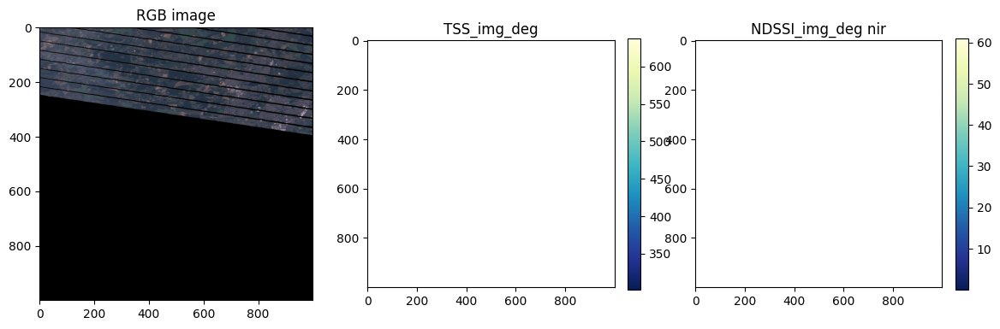

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


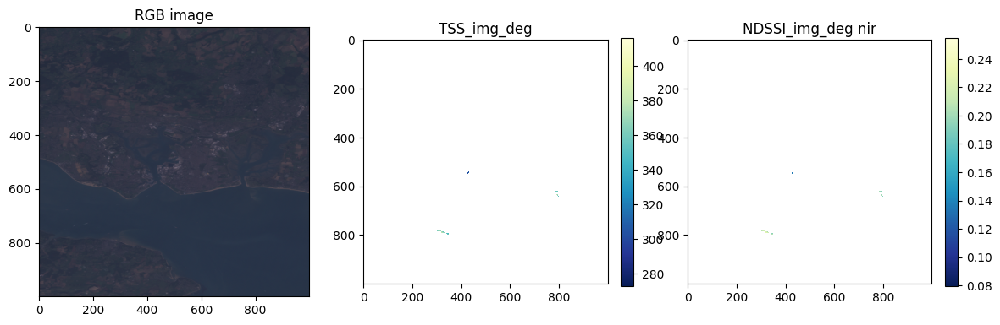

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


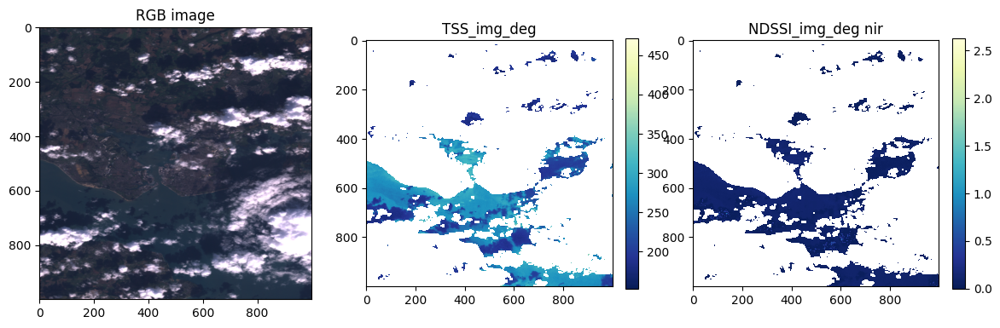

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


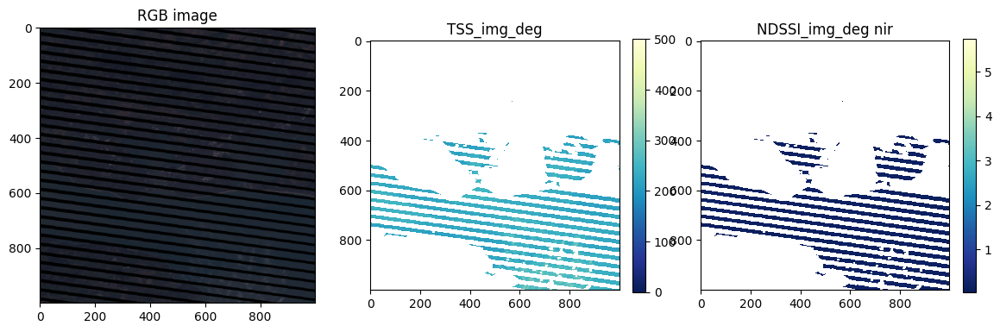

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


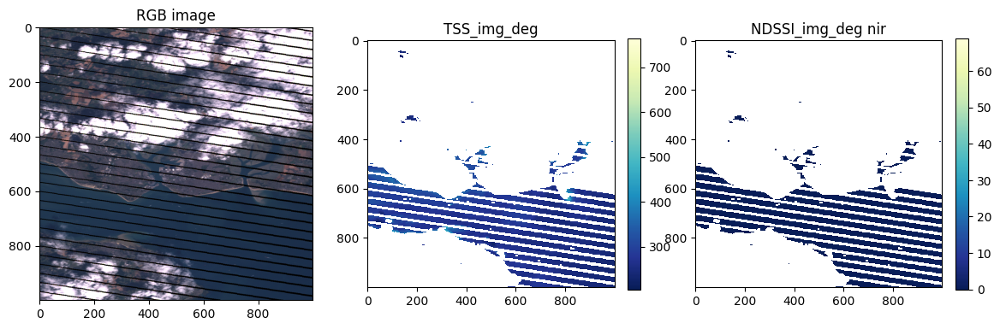

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


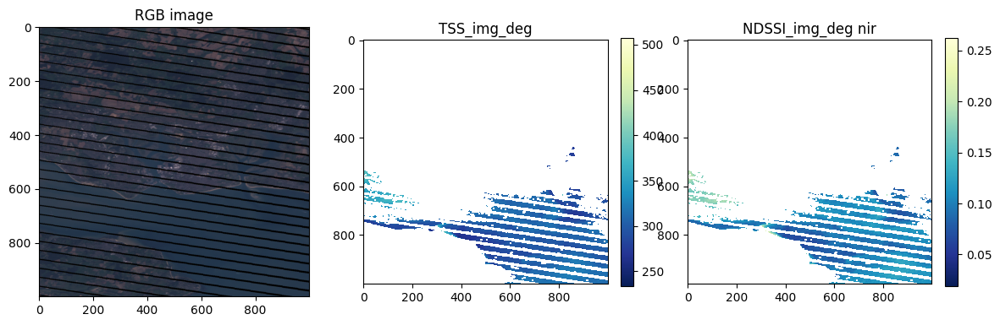

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


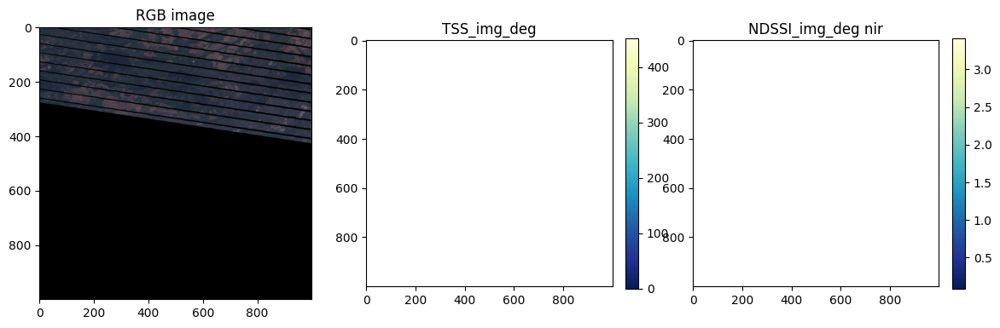

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


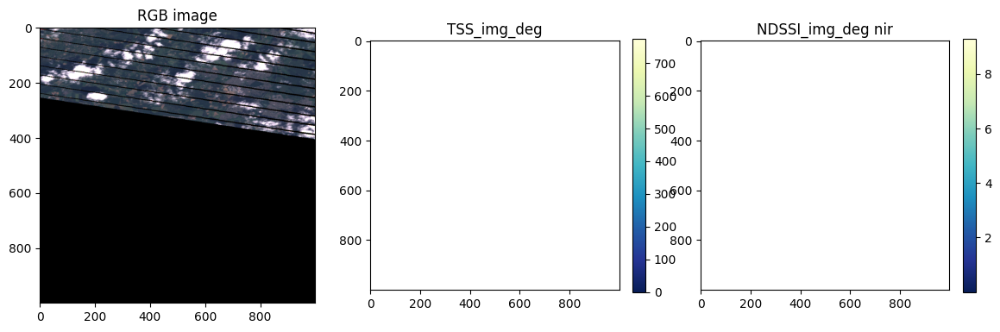

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


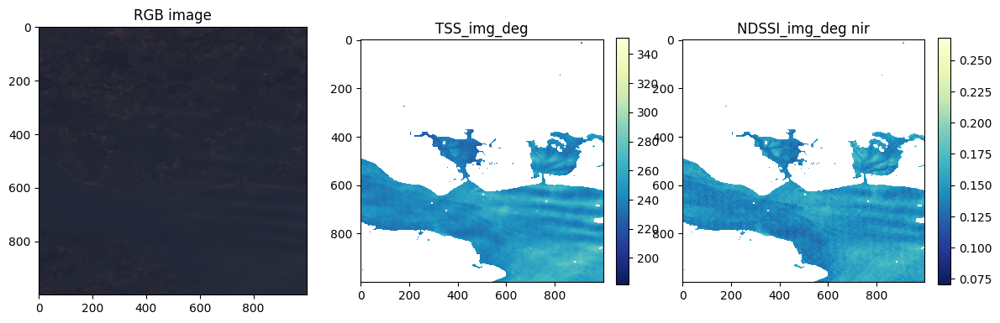

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


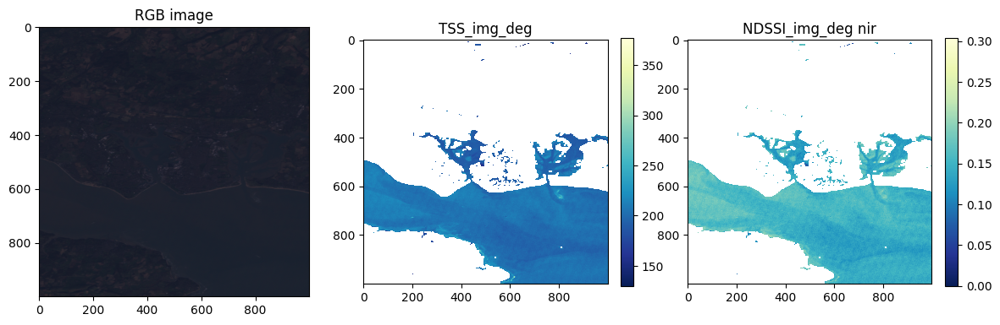

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


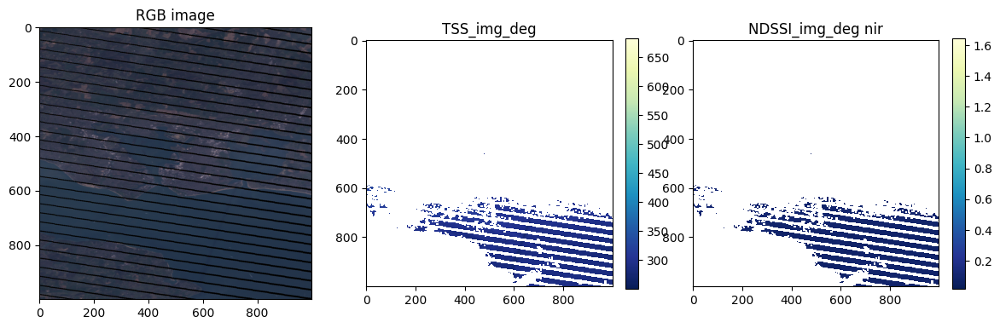

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


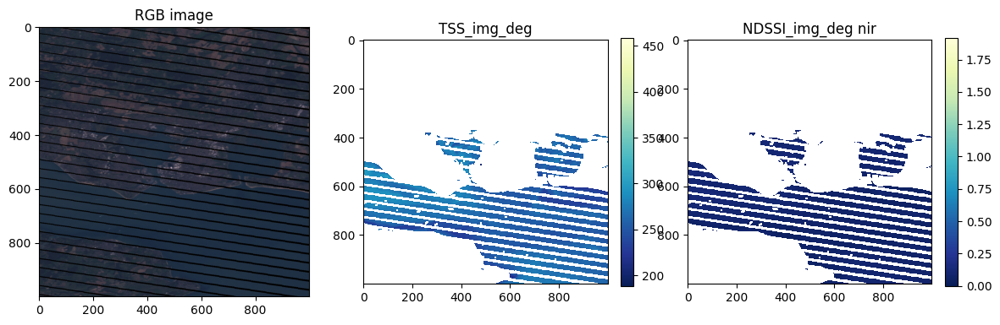

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


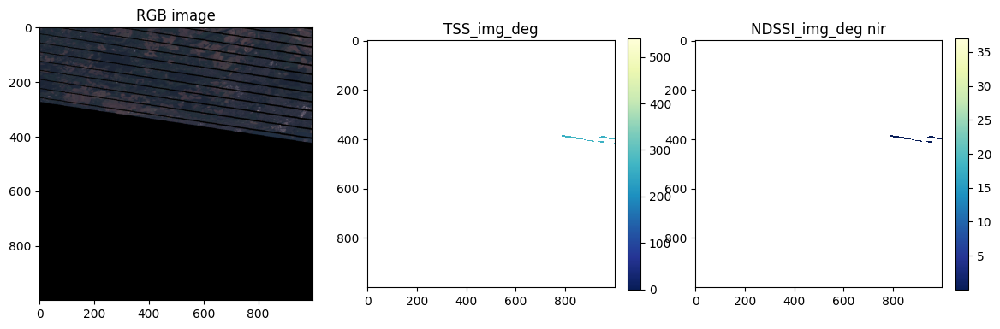

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


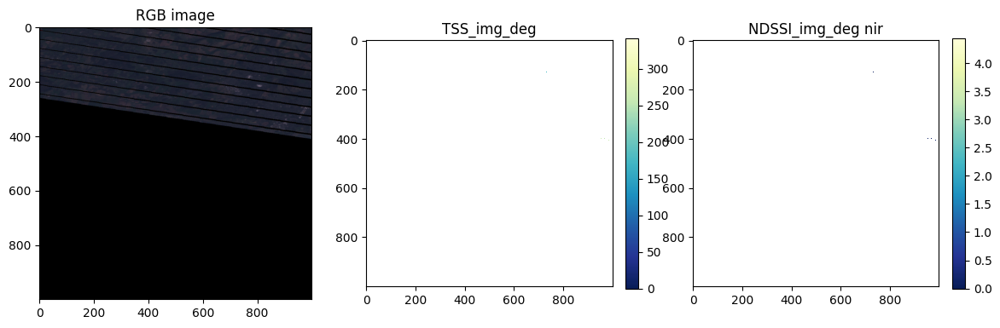

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


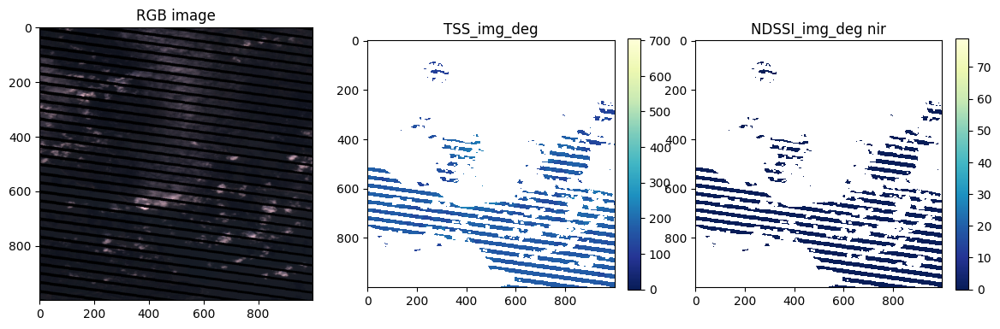

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


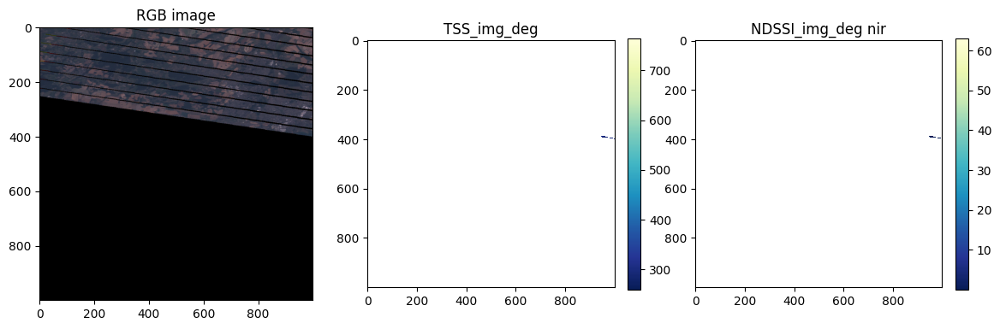

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


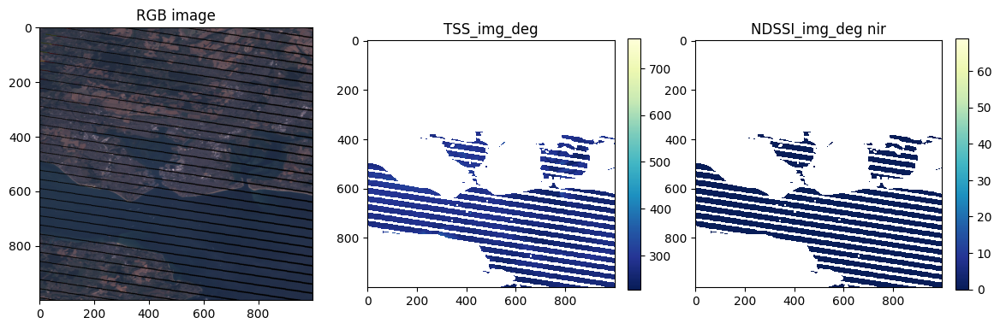

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


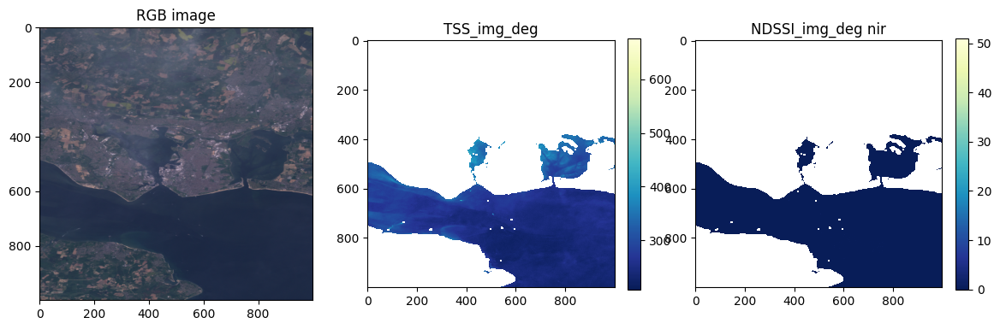

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


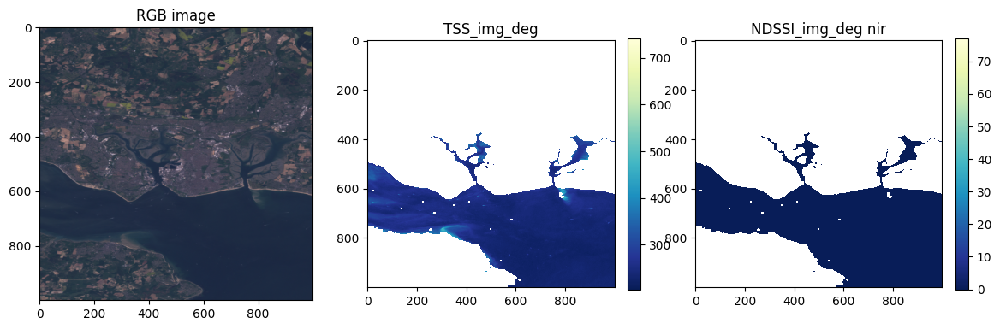

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


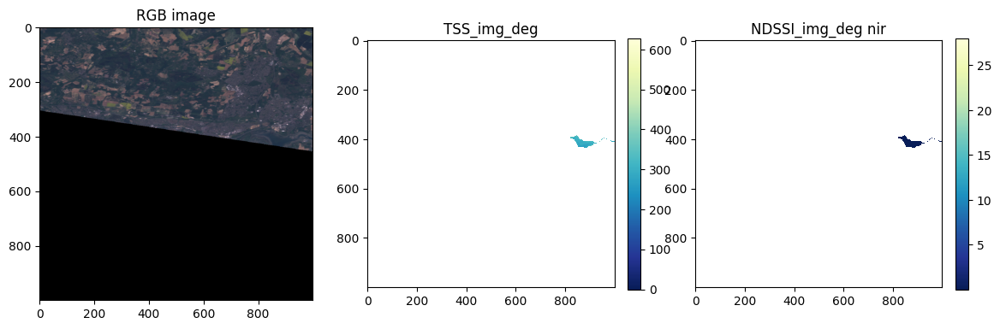

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


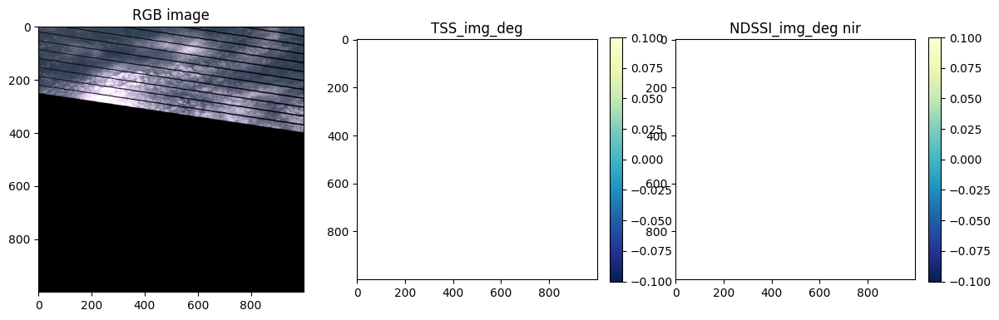

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


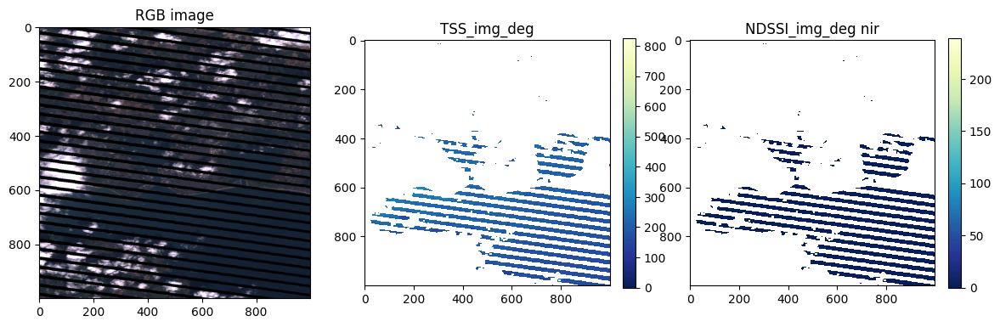

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


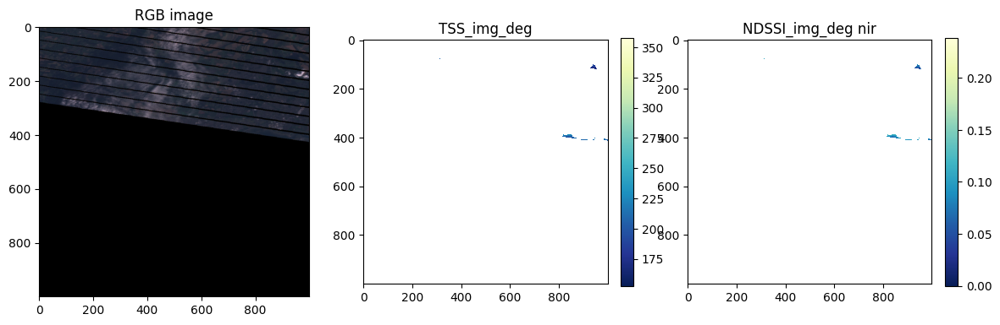

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


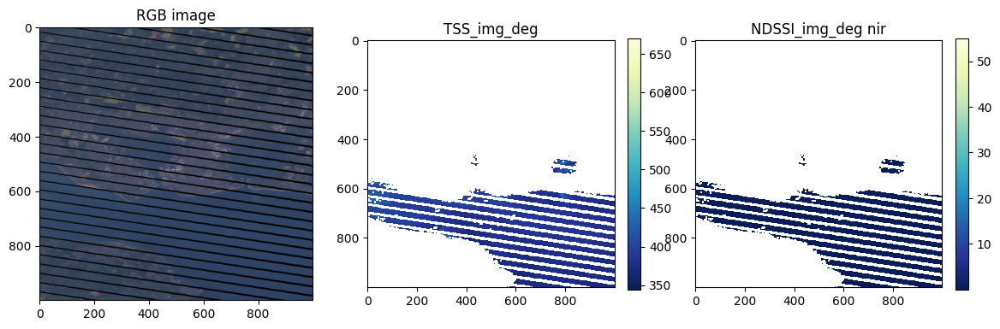

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


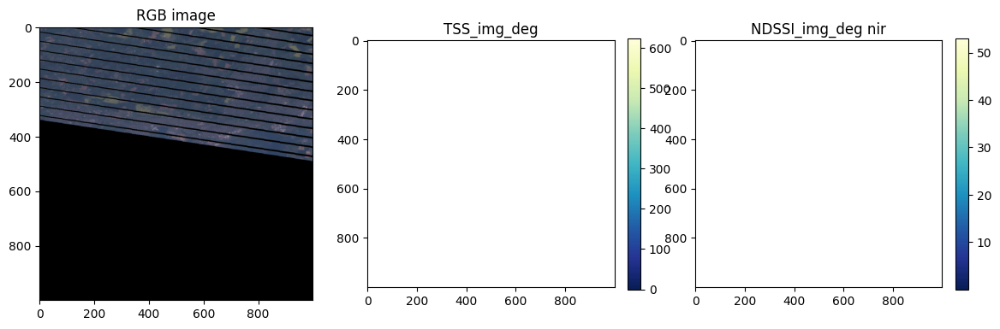

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


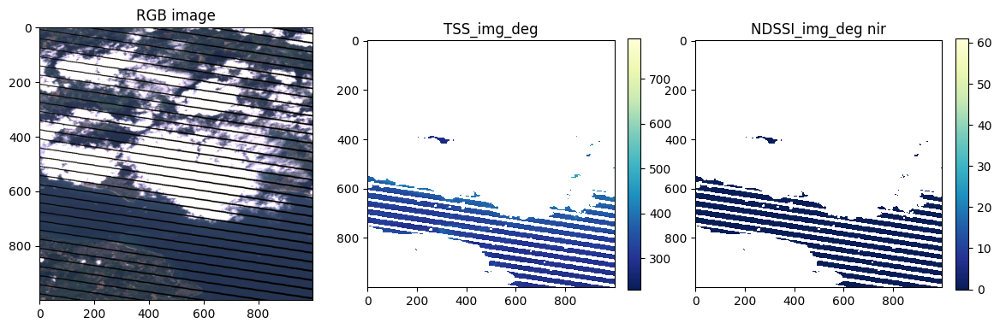

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


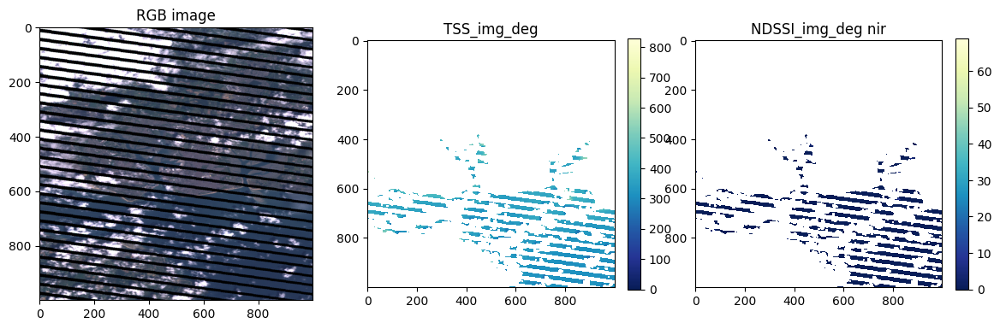

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


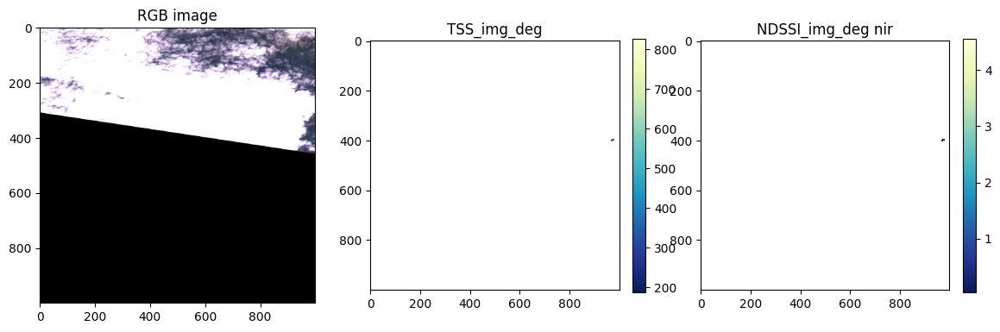

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


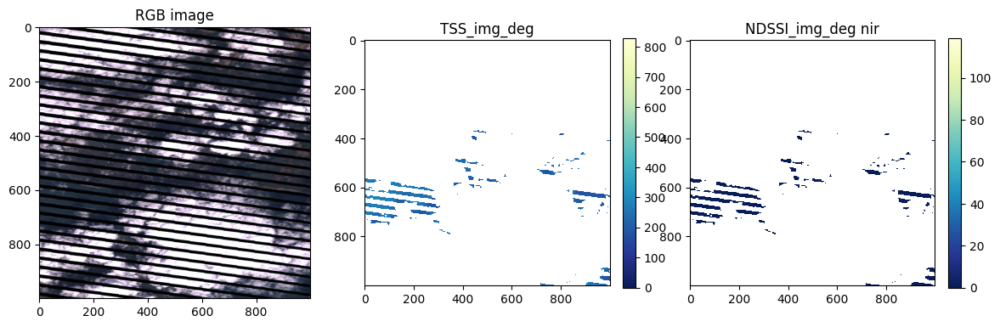

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


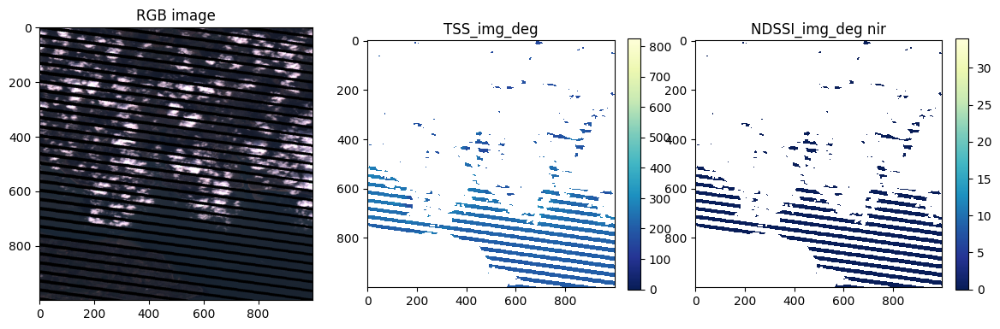

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


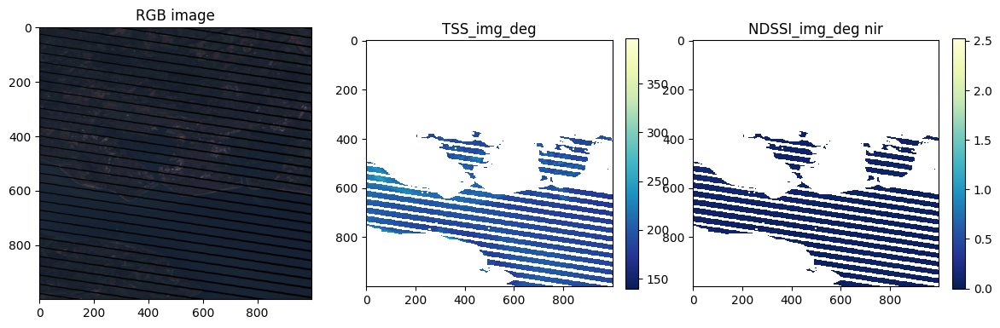

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


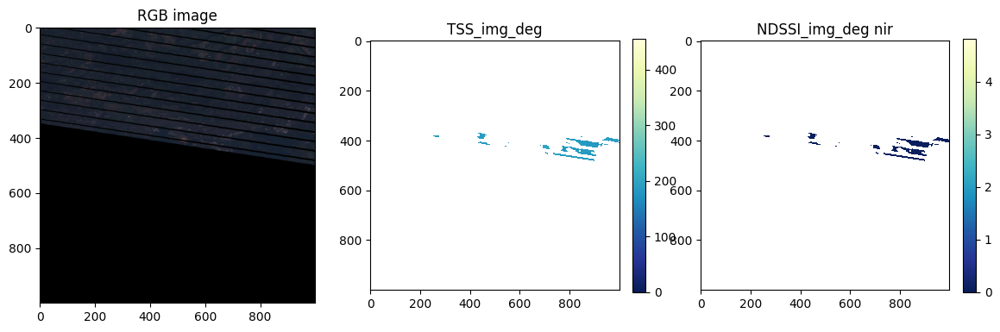

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


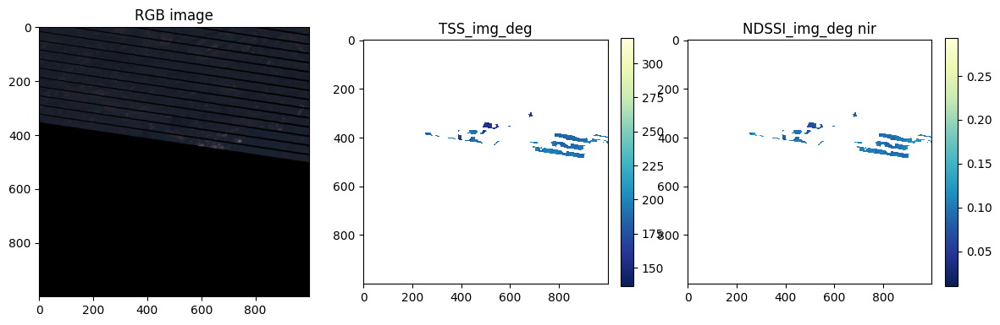

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


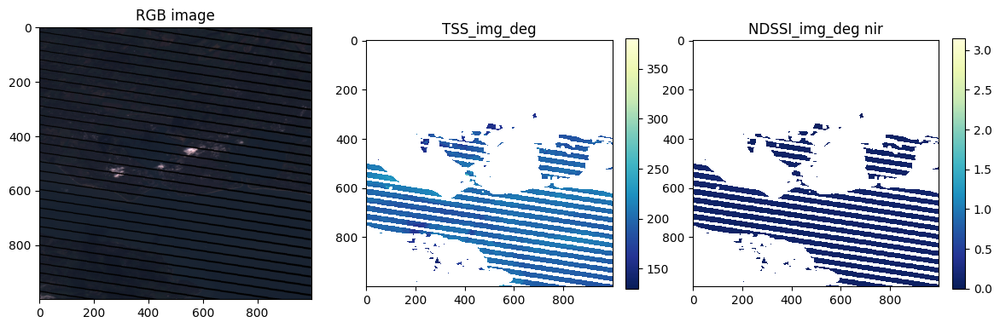

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


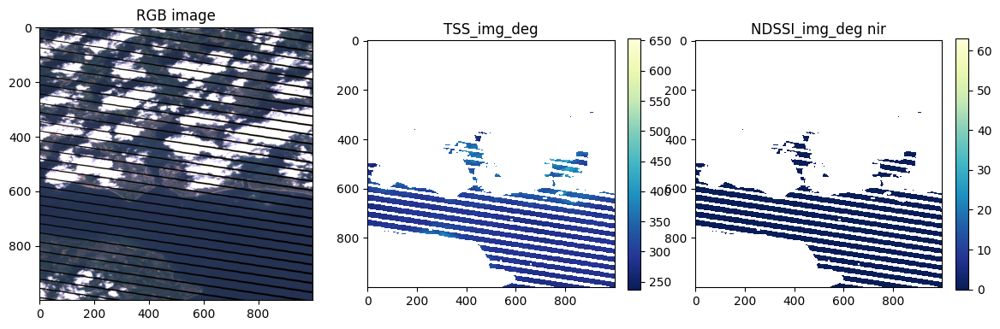

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


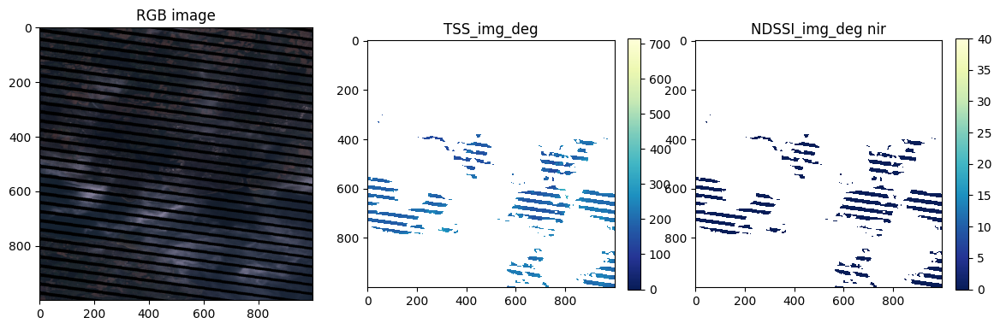

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


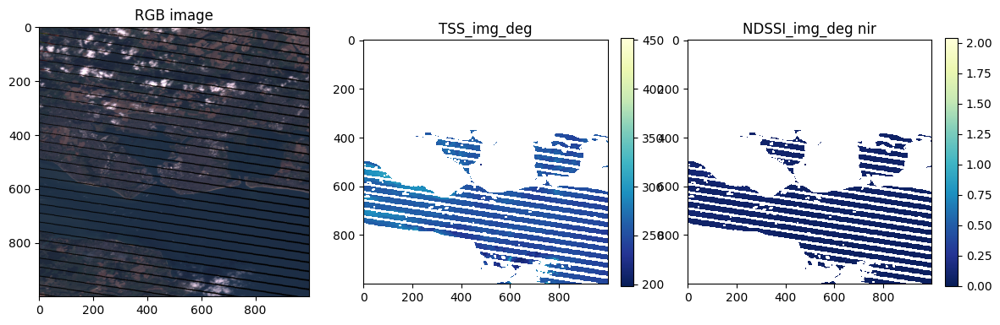

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


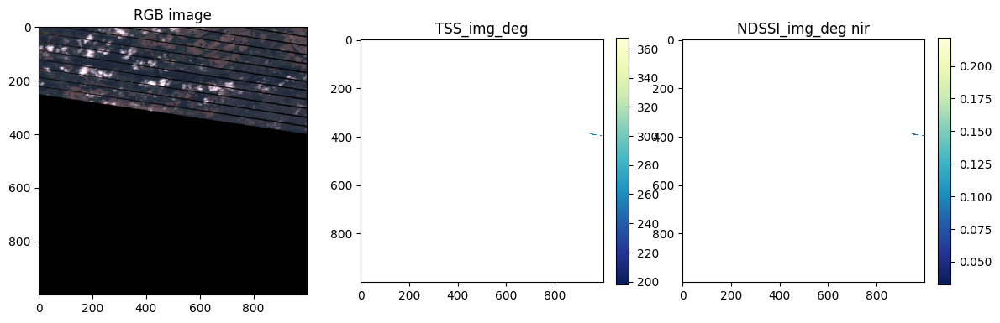

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


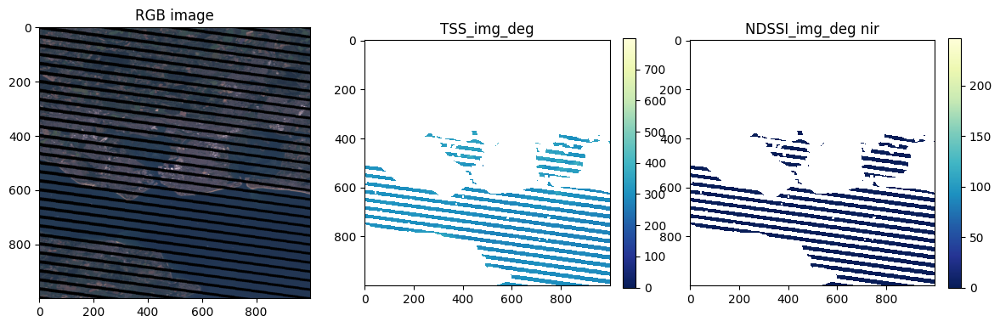

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


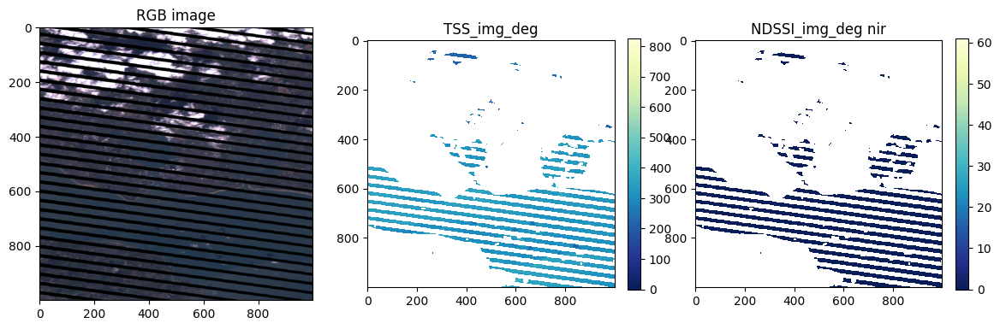

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


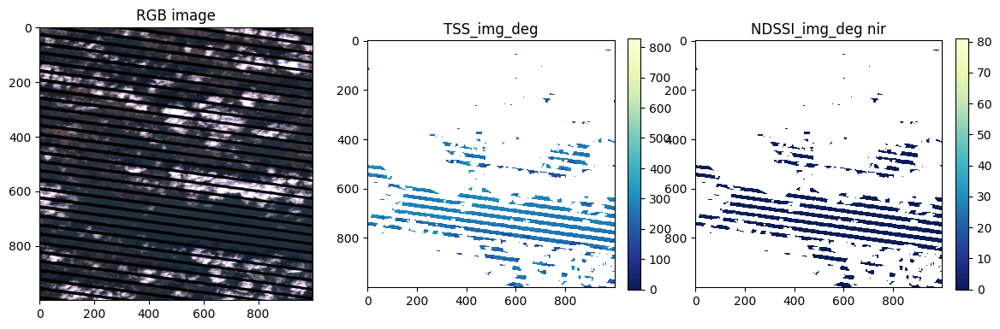

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


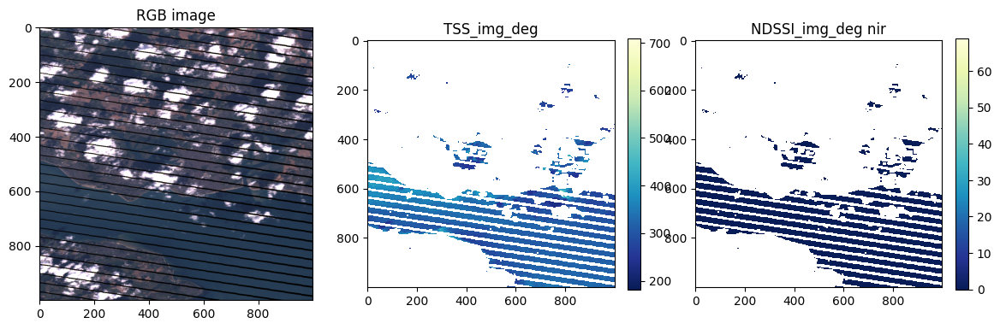

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


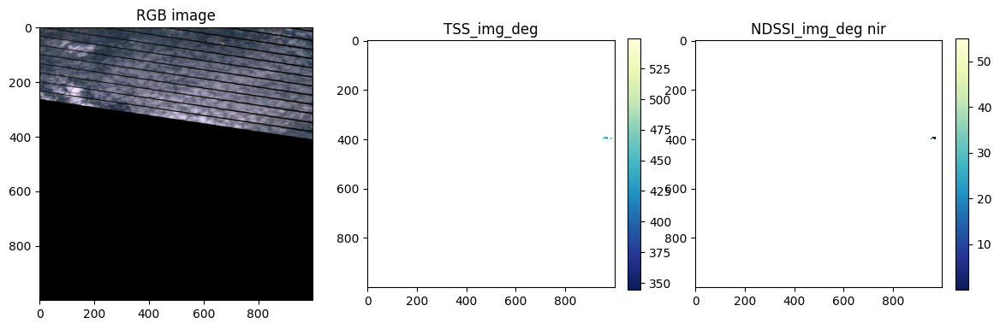

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


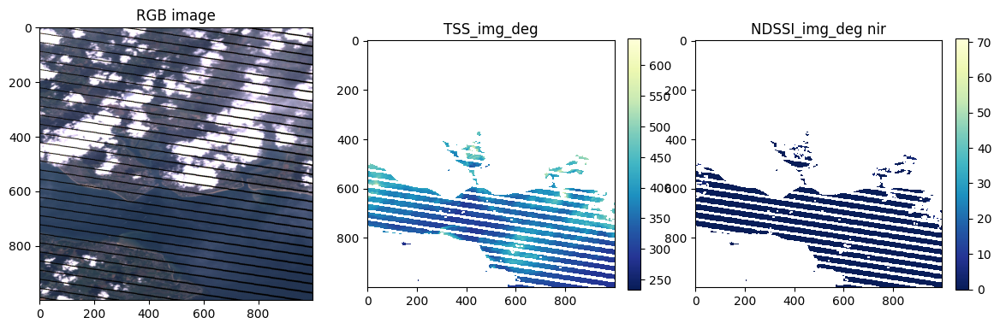

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


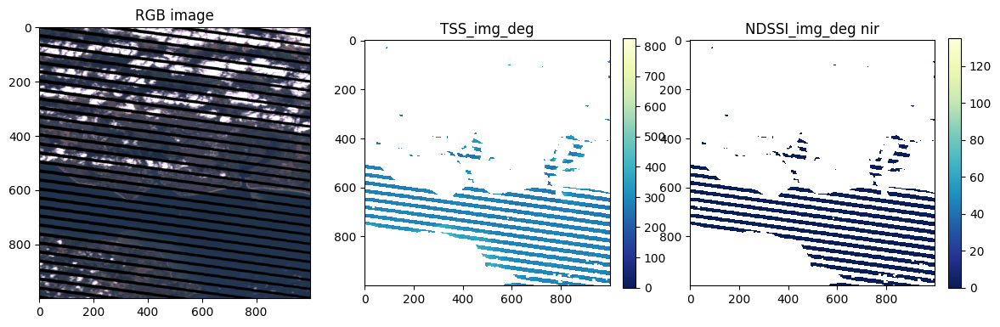

In [50]:
TSS_arr, NSMI_arr = sediment_val_dist('./L7/Portsmouth', scaler = scaler_BCLW, nn = BCLWMasks)

In [51]:
TSS_arr = np.array(TSS_arr).flatten()
NSMI_arr = np.array(NSMI_arr).flatten()

(array([1.8814623e+07, 9.7440000e+03, 1.7240000e+03, 2.4000000e+01,
        4.0000000e+00, 7.0000000e+00, 0.0000000e+00, 0.0000000e+00,
        0.0000000e+00, 7.0000000e+00]),
 array([  0. ,  24.7,  49.4,  74.1,  98.8, 123.5, 148.2, 172.9, 197.6,
        222.3, 247. ]),
 <BarContainer object of 10 artists>)

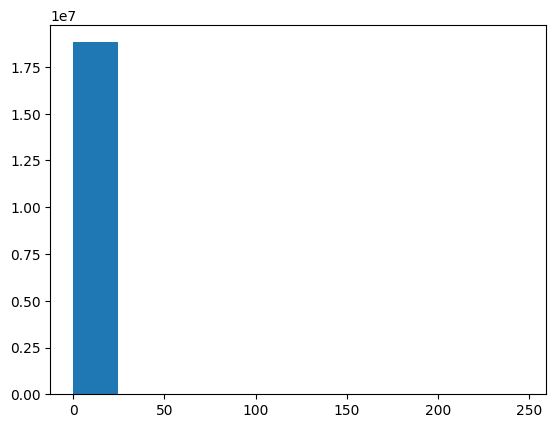

In [53]:
plt.hist(NSMI_arr[np.isfinite(NSMI_arr)])


In [54]:
TSS_arr_qmin, TSS_arr_qmax = np.nanquantile(TSS_arr, [0.2, 0.8])
NSMI_arr_qmin, NSMI_arr_qmax = np.nanquantile(NSMI_arr[np.isfinite(NSMI_arr)], [0.2, 0.8])

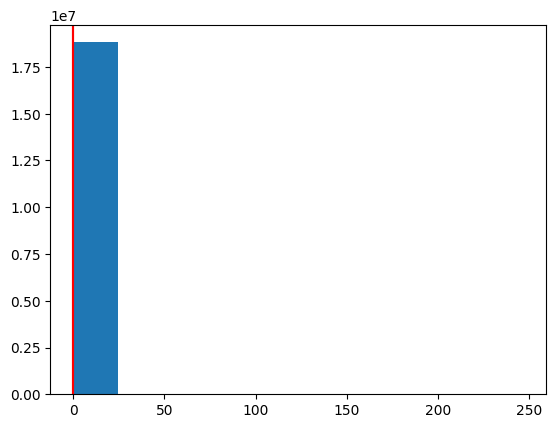

In [55]:
plt.hist(NSMI_arr[np.isfinite(NSMI_arr)])
plt.axvline(NSMI_arr_qmin, color="red")
plt.axvline(NSMI_arr_qmax, color="red")

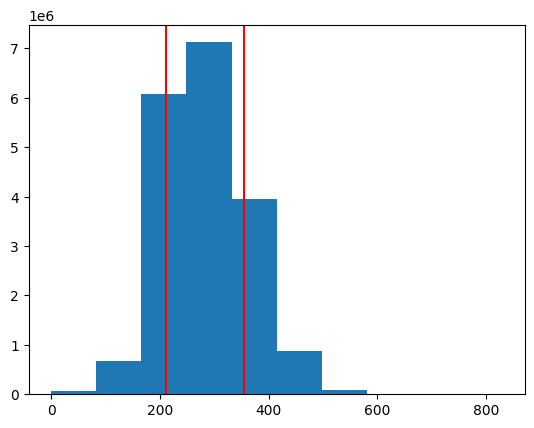

In [56]:
plt.hist(TSS_arr)
plt.axvline(TSS_arr_qmin, color="red")
plt.axvline(TSS_arr_qmax, color="red")

In [57]:
import pandas as pd

In [58]:
coast = np.load("water_mask.npy").reshape(1000, 1000)

In [59]:
columns_ = ['date', 'satellite',  'NSMI_tot', 'NSMI_mean', 'NSMI_median',\
           'NSMI_tot20', 'NSMI_mean20', 'NSMI_median20',\
           'NSMI_totpix20', 'NSMI_totpix80',\
           'TSS_tot', 'TSS_mean', 'TSS_median',\
           'TSS_tot20', 'TSS_mean20', 'TSS_median20',\
           'TSS_totpix20', 'TSS_totpix80']
results_df = pd.DataFrame(columns=columns_)

In [65]:
def sediment_analysis(path_main_directory, results_df, columns):
    if not os.path.isdir(path_main_directory):
        return "Main directory does not exist."

    contents = os.listdir(path_main_directory)

    subdirectory = path_main_directory
    list_date = os.listdir(subdirectory)

    results = []

    water_inter = np.zeros(shape=(1000000))
    for dirpath, dirnames, filenames in os.walk(subdirectory):
        if filenames:
            for filename in filenames:


                file_path = os.path.join(dirpath, filename)
                date = filename[-12:-4]

                # Plotting and image processing starts here
                if os.path.isfile(file_path) == True:

                    RAW_reader = rasterio.open(file_path)
                    image_shape = RAW_reader.read(1).shape
                    raw_image = np.dstack([
                    RAW_reader.read(1)/255*65535*1.0333-0.0029,
                    RAW_reader.read(2)/255*65535*0.9885+ 0.0014,
                    RAW_reader.read(3)/255*65535*1.0026+0.0009,
                    RAW_reader.read(4)/255*65535*1.1007-0.0058,
                    RAW_reader.read(5)/255*65535*1.0659-0.0001,
                    RAW_reader.read(8)/255*65535*1.0983+0.0048,
                    ])

                    test_image_water = scaler_BCLW.transform(raw_image.reshape((image_shape[0], image_shape[1], 6)))
                    test_image_water = np.clip(test_image_water, 0.06047150377660792, 1.)
                    
                    predictions = BCLWMasks(test_image_water.reshape((np.product(image_shape), 6)))
                    predicted_classes = np.argmax(predictions, axis=1)
                    water_mask = predictions[:,1]
                    water_mask = np.where(water_mask > 0.80, True, False)
                    
                    water_mask = water_mask.reshape((image_shape[0], image_shape[1]))
                    if len(np.where(water_mask == True)[0]) > 200000:
                        
                        TSS_img = Sediment(RAW_reader, predicted_classes.reshape((image_shape[0], image_shape[1]))).TSS().reshape((image_shape[0], image_shape[1]))
                        NSMI_img = Sediment(RAW_reader, predicted_classes.reshape((image_shape[0], image_shape[1]))).NSMI().reshape((image_shape[0], image_shape[1]))
                                                
                        NSMI_img = NSMI_img[np.isfinite(NSMI_img)]
                        
                        NSMI_tot = np.nansum(NSMI_img)
                        NSMI_mean = np.nanmean(NSMI_img)
                        NSMI_med = np.nanmedian(NSMI_img)
                        print(NSMI_tot, NSMI_mean, NSMI_med)
                        NSMI_tot20 = np.nansum(NSMI_img[NSMI_img>NSMI_arr_qmin])
                        NSMI_mean20 = np.nanmean(NSMI_img[NSMI_img>NSMI_arr_qmin])
                        NSMI_med20 = np.nanmedian(NSMI_img[NSMI_img>NSMI_arr_qmin])
                        
                        TSS_tot = np.nansum(TSS_img)
                        TSS_mean = np.nanmean(TSS_img)
                        TSS_med = np.nanmedian(TSS_img)
                        
                        TSS_tot20 = np.nansum(TSS_img[TSS_img>TSS_arr_qmin])
                        TSS_mean20 = np.nanmean(TSS_img[TSS_img>TSS_arr_qmin])
                        TSS_med20 = np.nanmedian(TSS_img[TSS_img>TSS_arr_qmin])
                        
                        NSMI_totpix20 = len(np.where((NSMI_img>NSMI_arr_qmin))[0])
                        TSS_totpix20 = len(np.where((TSS_img>TSS_arr_qmin))[0])
                        NSMI_totpix80 = len(np.where((NSMI_img>NSMI_arr_qmax))[0])
                        TSS_totpix80 = len(np.where((TSS_img>TSS_arr_qmax))[0])                                          
                        
                        
                        # Create a dictionary for the current row
                        row_data = {
                        'date': pd.to_datetime(date, format='%Y%m%d'),
                        'satellite': "L7",
                        'NSMI_tot': NSMI_tot,
                        'NSMI_mean': NSMI_mean,
                        'NSMI_med': NSMI_med,
                        'NSMI_tot20': NSMI_tot20,
                        'NSMI_med20': NSMI_med20,
                        'TSS_tot': TSS_tot,
                        'TSS_mean': TSS_mean,
                        'TSS_med': TSS_med,                          
                        'TSS_tot20':TSS_tot20,
                        'TSS_mean20':TSS_mean20,
                        'TSS_med20':TSS_med20,
                        'NSMI_totpix20':NSMI_totpix20,
                        'TSS_totpix20':TSS_totpix20,
                        'NSMI_totpix80':NSMI_totpix80,
                        'TSS_totpix80':TSS_totpix80                            
                        }
                        results.append(row_data)
                        
                        results_df = pd.DataFrame(results)
    return results_df

In [66]:
results_df_corr = sediment_analysis('./L7/Portsmouth', results_df, columns_)

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


49877.075319472664 0.20249469301040815 0.04


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


46357.019479884606 0.12468603103871703 0.06832298136645963


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


29851.057540299098 0.09477458905574548 0.09230769230769231


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


47338.880447331685 0.1759979791627878 0.037037037037037035


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


18741.043555213662 0.0727183409780874 0.0684931506849315


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


45236.77871441064 0.1809847596876576 0.1291866028708134


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


64015.38805456298 0.2297439260063702 0.12941176470588237


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


70360.80053626512 0.27428437983145937 0.05454545454545454


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


27917.09465865794 0.08591276318494383 0.07246376811594203


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


40814.02275647628 0.15473865642182233 0.15577889447236182


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


45900.114702780535 0.14660545250436152 0.13333333333333333


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


42205.11302964519 0.19680172077892885 0.1259259259259259


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


52886.33345844695 0.14483969977966338 0.14084507042253522


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


53937.83436264031 0.10983646937659153 0.10416666666666667


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


61016.910788599605 0.15894290787148366 0.16071428571428573


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


21699.921476507934 0.09940139747193359 0.096045197740113


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


35542.132463760696 0.12290915664534396 0.11724137931034483


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


28563.638016478177 0.07939636984789353 0.05555555555555555


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


27437.934539331465 0.09320235516483678 0.08695652173913043


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


35153.452762819616 0.11127186526765809 0.10179640718562874


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


91683.80096627693 0.3948586137724357 0.12264150943396226


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


397965.40333279787 1.3817091746965457 0.13537117903930132


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


53970.93921553317 0.21769234486325664 0.15476190476190477


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


43471.91930193722 0.13145384895097753 0.12222222222222222


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


179694.81188266558 0.7300304772459774 0.12389380530973451


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


44584.63515763975 0.15986172271872837 0.07272727272727272


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


39095.98225569216 0.1105696257376322 0.10476190476190476


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


50139.23356085853 0.17827599978971548 0.178743961352657


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


30055.295487377043 0.1200281766414687 0.07103825136612021


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


103429.23488721607 0.3510740878971924 0.11711711711711711


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


60837.63719260824 0.21084865092729266 0.1320754716981132


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


56940.189222423454 0.21394664961720983 0.07368421052631578


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


27524.30036120122 0.09821268130540094 0.09803921568627451


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


67650.05215066357 0.2523455327626073 0.168


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


42110.786485777884 0.15002970071496274 0.04093567251461988


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


25490.41184615768 0.11241339521846248 0.10714285714285714


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


64503.75303870959 0.15090432763449493 0.14960629921259844


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


67565.31657915551 0.14720914337198215 0.14814814814814814


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


19755.737083177846 0.09280832581613713 0.09195402298850575


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


26180.065449706843 0.0848698766171005 0.08333333333333333


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


74738.63388831227 0.2680591142780214 0.17391304347826086


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


26791.36708222981 0.08277447834419267 0.07317073170731707


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


24547.483682274076 0.06994083248742525 0.0547945205479452


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


24585.05281305078 0.07327884594053884 0.050359712230215826


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


40752.62927261945 0.16833182266868013 0.06086956521739131


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


25223.121995655285 0.09812649824995151 0.07407407407407407


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


31240.529378358864 0.13876785374701886 0.06060606060606061


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


48059.872164492146 0.19793527410563225 0.125


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


22784.225586288252 0.07201947637923724 0.06542056074766354


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


38527.288706208536 0.10933139052245676 0.10714285714285714


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


23250.50603324008 0.08257832706428922 0.04597701149425287


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


19293.780907375607 0.06289884661549117 0.06040268456375839


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


26731.130488151703 0.10520463655421845 0.04597701149425287


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


52296.31047899941 0.19205261246336572 0.14942528735632185


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


44189.14882799092 0.2107446493864056 0.14666666666666667


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


32632.87832474185 0.10400751645309828 0.07954545454545454


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


121676.80465466484 0.43853818443979253 0.07964601769911504


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


29240.937114422737 0.1173081652308086 0.05732484076433121


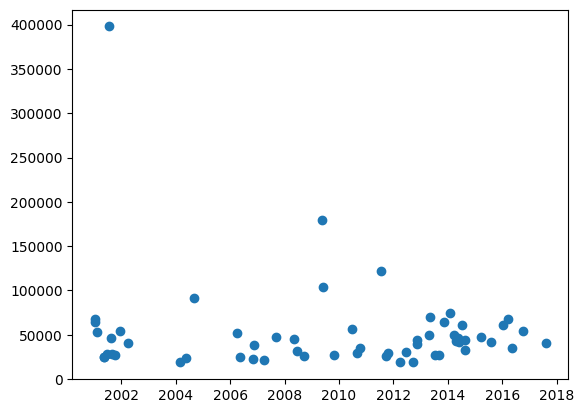

In [67]:
plt.scatter(results_df_corr["date"], results_df_corr["NSMI_tot"])

plt.show()

In [68]:
results_df_corr.to_csv('L7_sediment.csv', index=False)  

In [69]:
def create_circular_mask(h, w, center=None, radius=None):

    if center is None: # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None: # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)

    mask = dist_from_center <= radius
    return mask

In [70]:
circular_mask_0 = create_circular_mask(1000, 1000,  [500, 500], 100)

In [71]:
results_df_0 = pd.DataFrame(columns=columns_)

In [72]:
def sediment_analysis_circle(path_main_directory, results_df, columns, circle_mask):
    if not os.path.isdir(path_main_directory):
        return "Main directory does not exist."

    contents = os.listdir(path_main_directory)

    subdirectory = path_main_directory
    list_date = os.listdir(subdirectory)

    results = []

    water_inter = np.zeros(shape=(1000000))
    for dirpath, dirnames, filenames in os.walk(subdirectory):
        if filenames:
            for filename in filenames:


                file_path = os.path.join(dirpath, filename)
                date = filename[-12:-4]

                # Plotting and image processing starts here
                if os.path.isfile(file_path) == True:

                  RAW_reader = rasterio.open(file_path)
                  image_shape = RAW_reader.read(1).shape
                  raw_image = np.dstack([
                      RAW_reader.read(1)/255*65535*1.0333-0.0029,
                      RAW_reader.read(2)/255*65535*0.9885+ 0.0014,
                      RAW_reader.read(3)/255*65535*1.0026+0.0009,
                      RAW_reader.read(4)/255*65535*1.1007-0.0058,
                      RAW_reader.read(5)/255*65535*1.0659-0.0001,
                      RAW_reader.read(8)/255*65535*1.0983+0.0048,
                  ])

                  test_image_water = scaler_BCLW.transform(raw_image.reshape((image_shape[0], image_shape[1], 6)))
                  test_image_water = np.clip(test_image_water, 0.06047150377660792, 1.)

                  predictions = BCLWMasks(test_image_water.reshape((np.product(image_shape), 6)))
                  predicted_classes = np.argmax(predictions, axis=1)
                  water_mask = predictions[:,1]
                  water_mask = np.where(water_mask > 0.80, True, False)
                  #water_mask[(intertidal_mask.flatten()==True)&(cloud_mask<0.25)&(blank_mask<0.25)] = 1
                  water_mask = water_mask.reshape((image_shape[0], image_shape[1]))
                  if len(np.where(water_mask == True)[0]) > 200000:

                      water_mask = np.where((water_mask==1)&(circle_mask==1), 1, 0)
                      rgb_image  = scale_im(RAW_reader)
                      # Plotting
                      fig, ax = plt.subplots(1, 2, figsize=(6,6.5))
                      ax[0].imshow(rgb_image)
                      ax[0].title.set_text('RGB image')
    
    
                      ax[1].imshow(water_mask)
                      plt.show()
    
                      TSS_img = Sediment(RAW_reader, predicted_classes.reshape((image_shape[0], image_shape[1]))).TSS().reshape((image_shape[0], image_shape[1]))
                      NSMI_img = Sediment(RAW_reader, predicted_classes.reshape((image_shape[0], image_shape[1]))).NSMI().reshape((image_shape[0], image_shape[1]))
                        
                      NSMI_img = NSMI_img[np.isfinite(NSMI_img)]

                      NSMI_tot = np.nansum(NSMI_img)
                      NSMI_mean = np.nanmean(NSMI_img)
                      NSMI_med = np.nanmedian(NSMI_img)

                      NSMI_tot20 = np.nansum(NSMI_img[NSMI_img>NSMI_arr_qmin])
                      NSMI_mean20 = np.nanmean(NSMI_img[NSMI_img>NSMI_arr_qmin])
                      NSMI_med20 = np.nanmedian(NSMI_img[NSMI_img>NSMI_arr_qmin])

                      TSS_tot = np.nansum(TSS_img)
                      TSS_mean = np.nanmean(TSS_img)
                      TSS_med = np.nanmedian(TSS_img)

                      TSS_tot20 = np.nansum(TSS_img[TSS_img>TSS_arr_qmin])
                      TSS_mean20 = np.nanmean(TSS_img[TSS_img>TSS_arr_qmin])
                      TSS_med20 = np.nanmedian(TSS_img[TSS_img>TSS_arr_qmin])

                      NSMI_totpix20 = len(np.where((NSMI_img>NSMI_arr_qmin))[0])
                      TSS_totpix20 = len(np.where((TSS_img>TSS_arr_qmin))[0])
                      NSMI_totpix80 = len(np.where((NSMI_img>NSMI_arr_qmax))[0])
                      TSS_totpix80 = len(np.where((TSS_img>TSS_arr_qmax))[0])                                          


                      # Create a dictionary for the current row
                      row_data = {
'date': pd.to_datetime(date, format='%Y%m%d'),
'satellite': "L7",
'NSMI_tot': NSMI_tot,
'NSMI_mean': NSMI_mean,
'NSMI_med': NSMI_med,
'NSMI_tot20': NSMI_tot20,
'NSMI_med20': NSMI_med20,
'TSS_tot': TSS_tot,
'TSS_mean': TSS_mean,
'TSS_med': TSS_med,                          
'TSS_tot20':TSS_tot20,
'TSS_mean20':TSS_mean20,
'TSS_med20':TSS_med20,
'NSMI_totpix20':NSMI_totpix20,
'TSS_totpix20':TSS_totpix20,
'NSMI_totpix80':NSMI_totpix80,
'TSS_totpix80':TSS_totpix80                            
                      }
                      results.append(row_data)

                      results_df = pd.DataFrame(results)
    return results_df

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


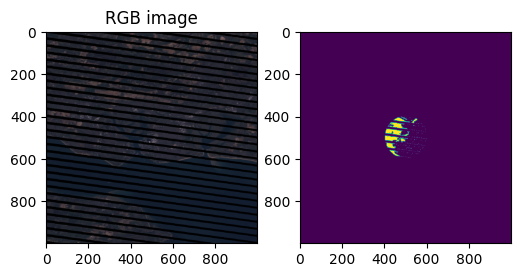

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


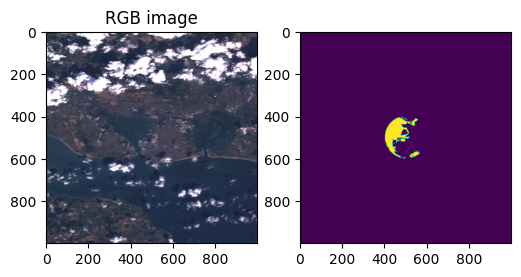

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


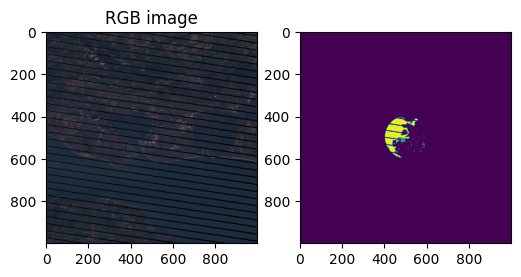

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


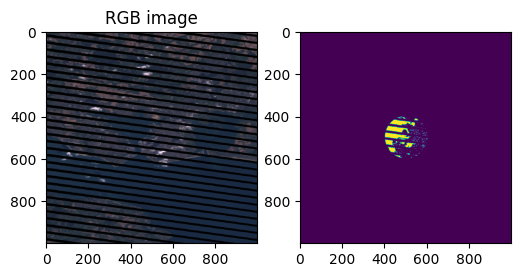

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


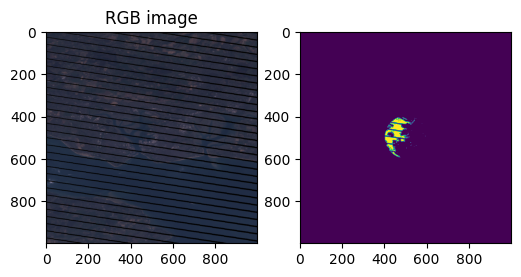

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


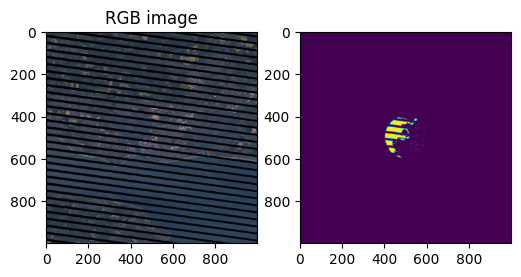

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


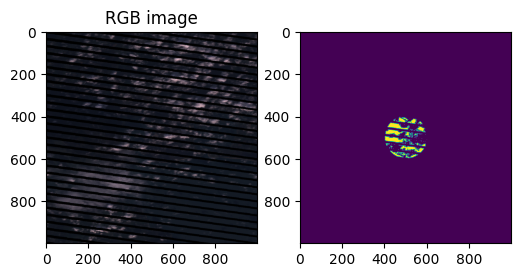

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


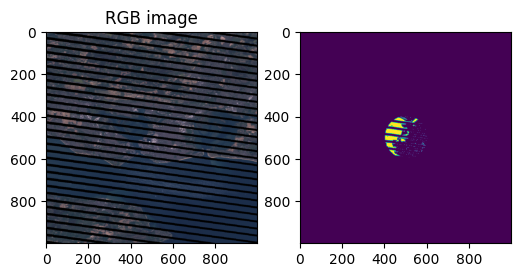

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


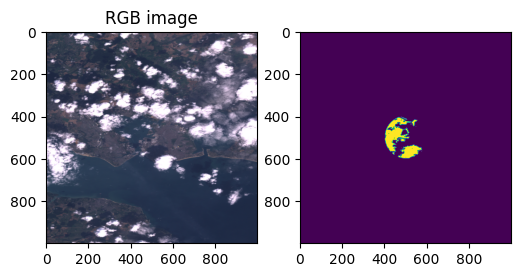

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


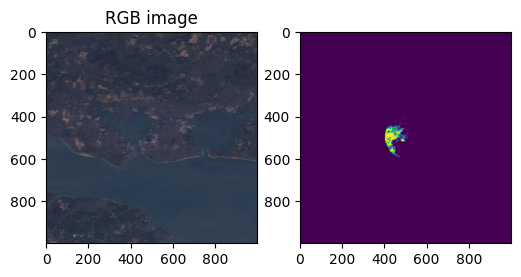

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


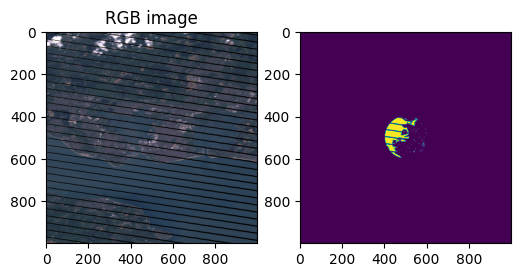

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


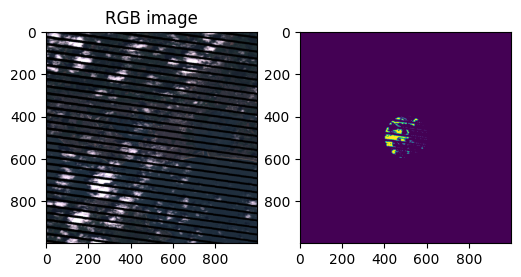

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


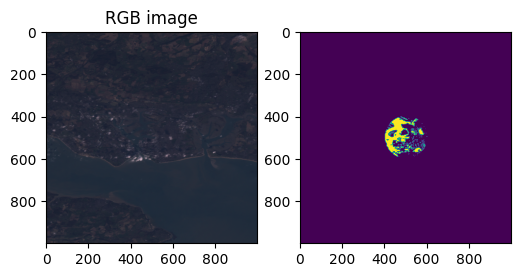

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


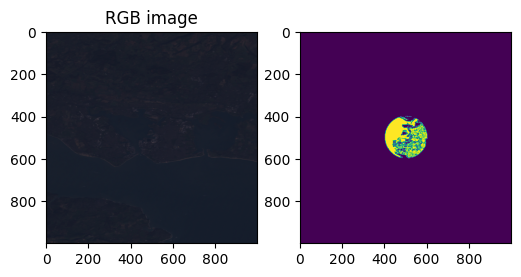

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


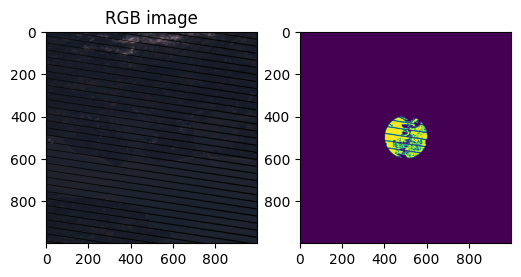

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


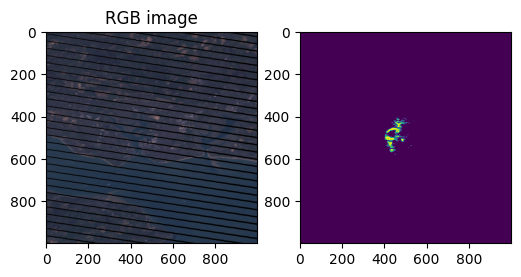

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


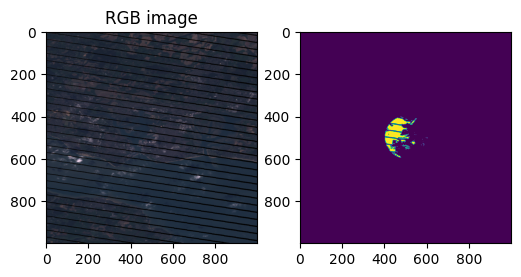

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


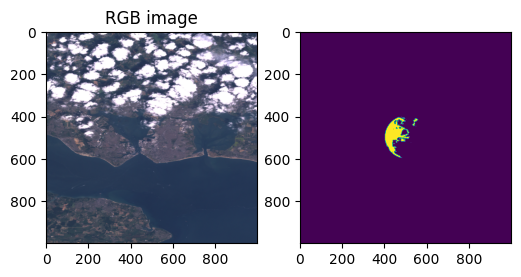

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


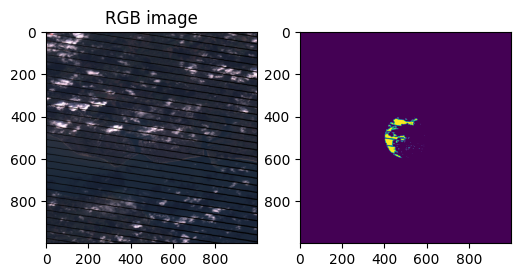

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


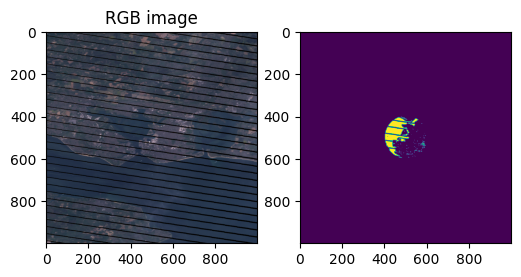

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


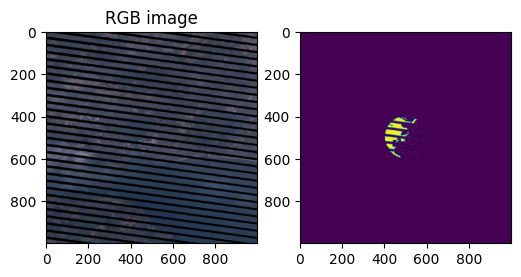

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


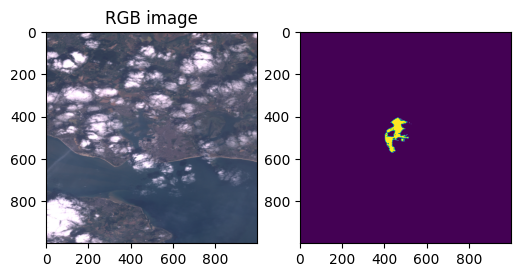

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


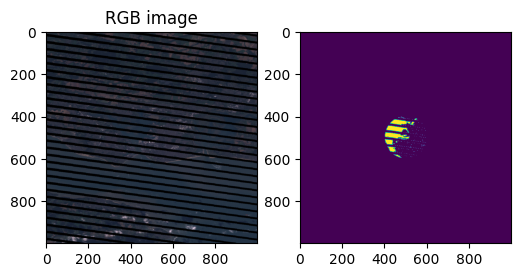

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


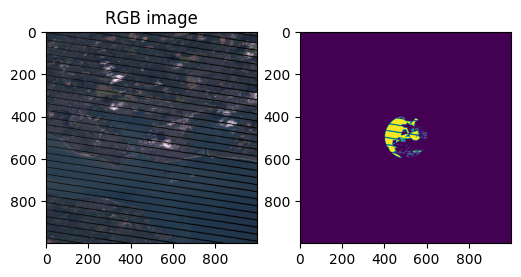

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


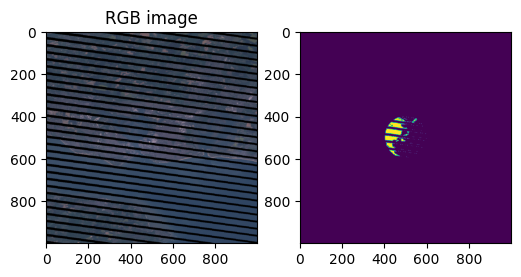

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


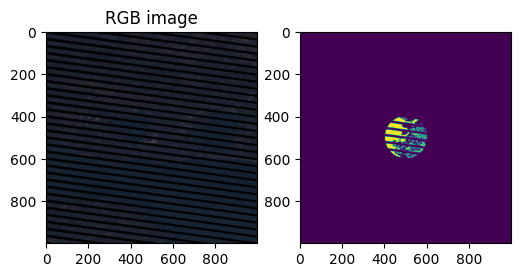

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


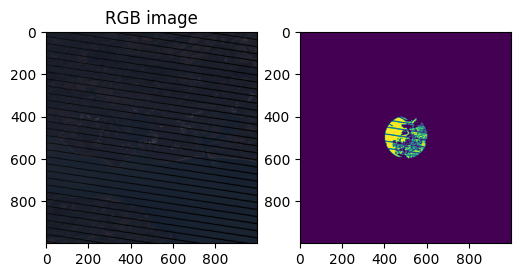

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


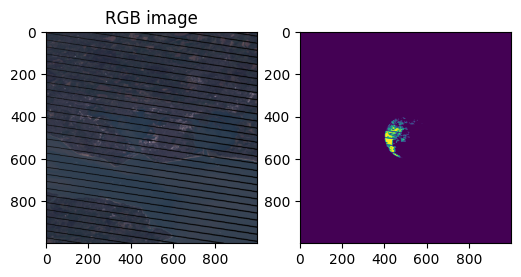

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


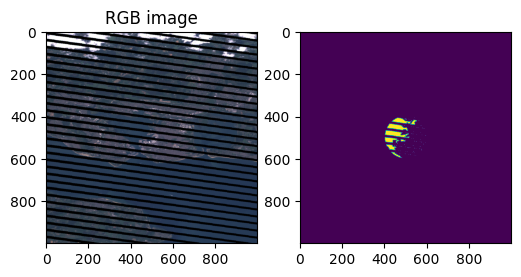

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


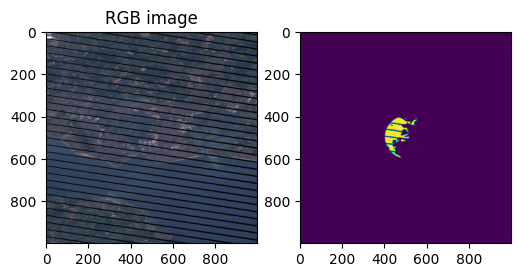

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


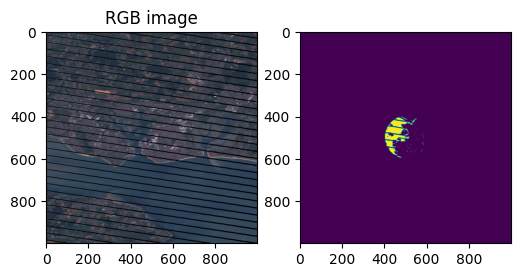

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


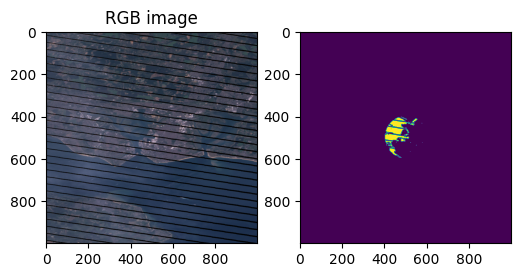

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


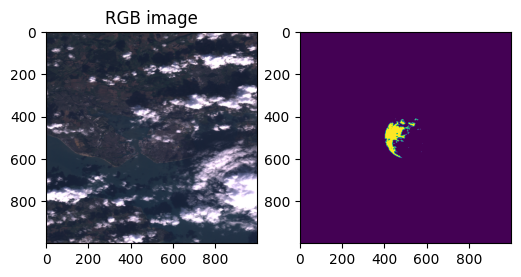

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


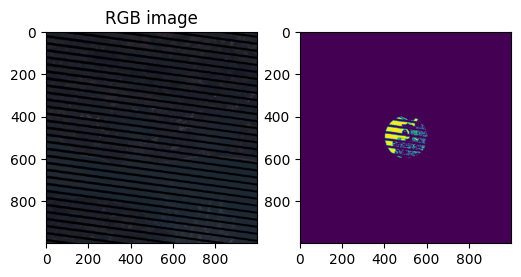

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


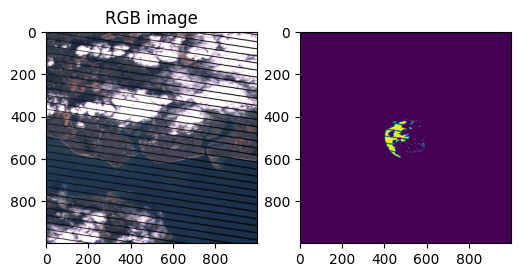

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


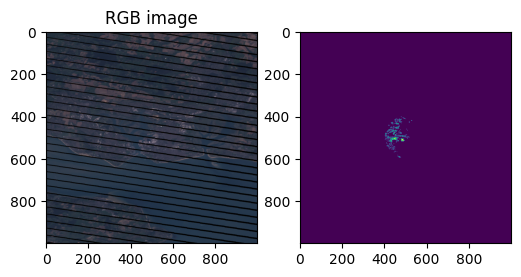

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


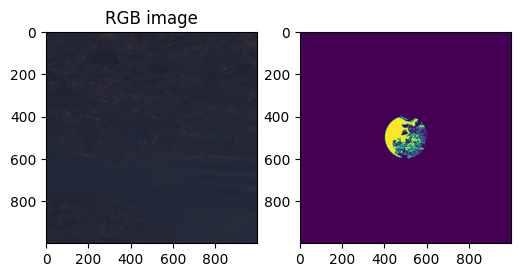

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


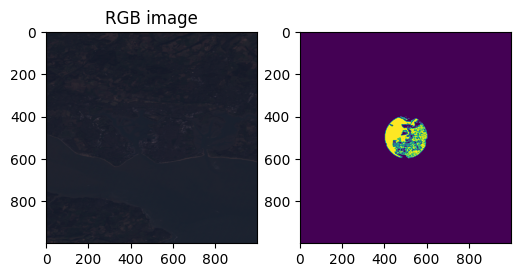

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


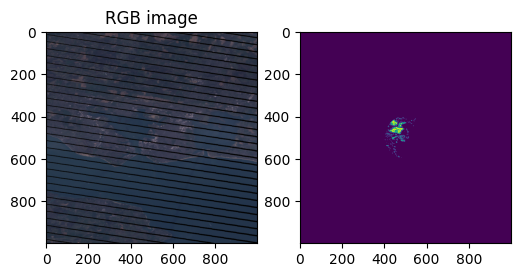

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


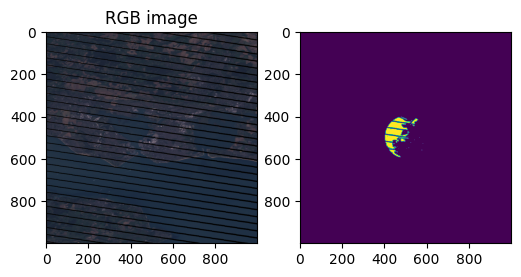

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


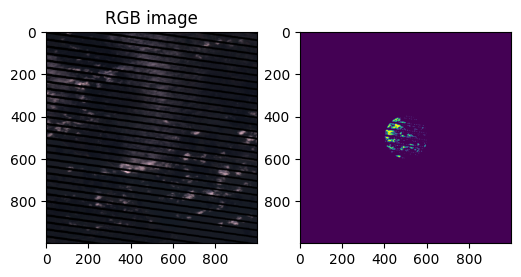

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


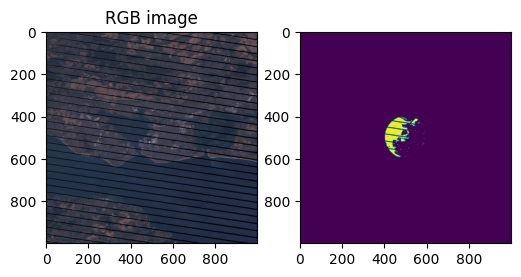

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


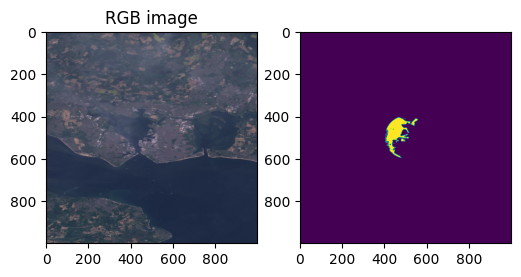

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


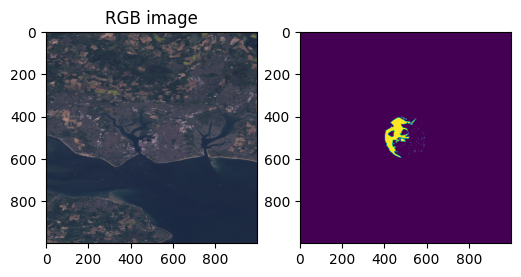

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


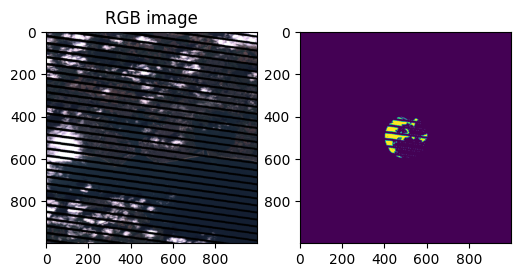

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


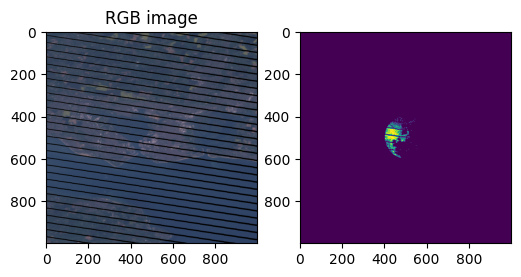

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


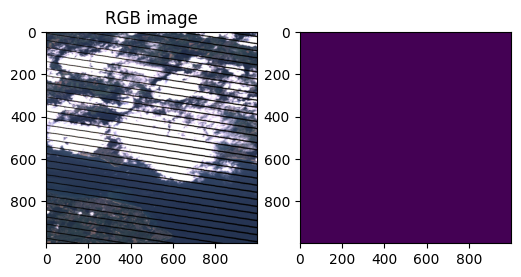

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


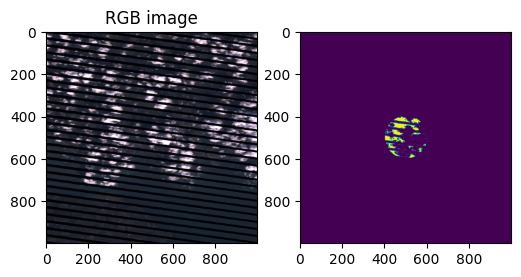

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


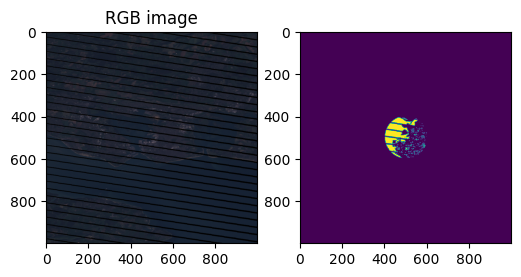

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


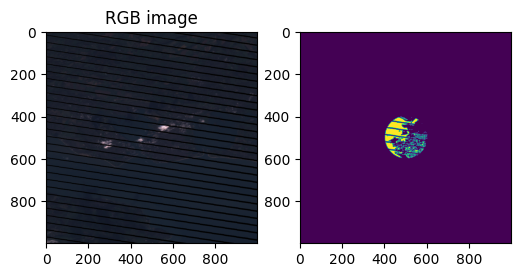

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


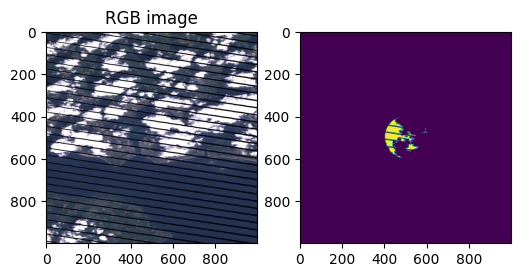

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


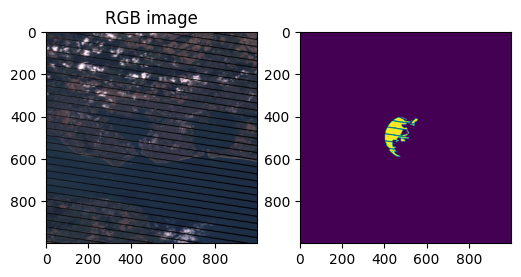

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


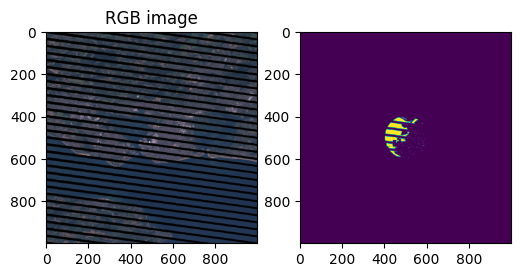

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


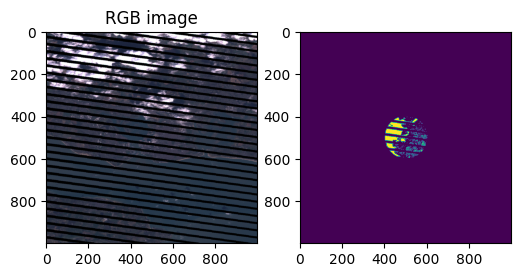

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


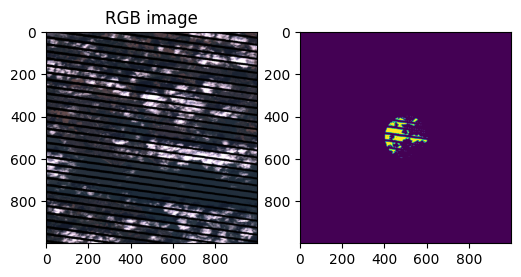

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


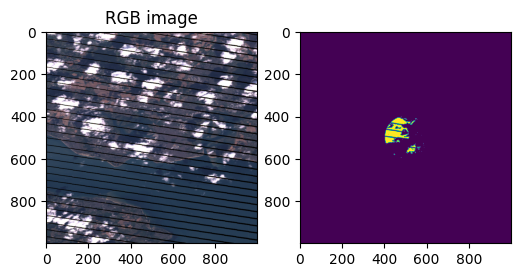

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


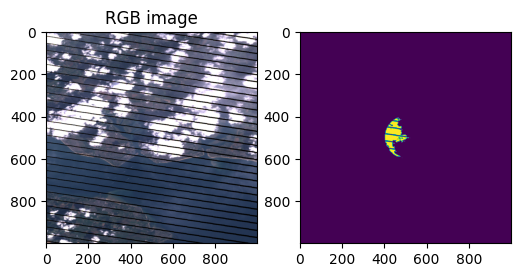

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


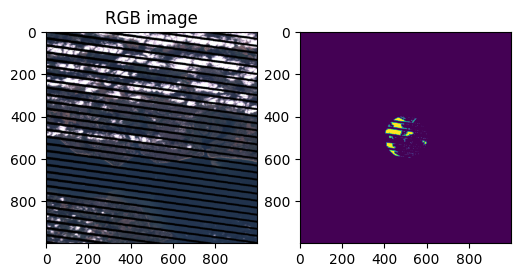

In [73]:
results_df_0 = sediment_analysis_circle('./L7/Portsmouth', results_df_0, columns_, circular_mask_0)

In [74]:
results_df_0.to_csv('L7_sediment_centre.csv', index=False)  